## ViT For Time series Images Cloud Recovery

**Description**

This mainly focuses on the image reconstruction performance before and after incorporating temporal sequences, after encoding the time parameters.
The input image format is [batch_size, channel, Width, Height], for example [10, 66, 180, 180]



In [1]:
# --------------------------------------------------------------------
# Importing required libraries
# --------------------------------------------------------------------

# Standard libraries
import random  # For generating random numbers
import numpy as np  # For numerical operations
import pandas as pd  # For handling tabular data
import PIL.Image as Image  # For image processing
from glob import glob  # For file pattern matching

# Custom model imports
from mymodels import (
    VisionTransformer,  # Vision Transformer for image-related tasks
    ReconNet,  # Reconstruction Network
    VisionTransformerTimeSeries,  # Vision Transformer adapted for time series
    VisionTransformerTimeSeriesFormalized,  # A formalized version of the time series Vision Transformer
)
from mymodels.unet import Unet  # U-Net model for segmentation tasks
from mymodels.discriminatorv2 import (
    Discriminator,
)  # Discriminator model (likely for GAN setup)

# Visualization
import matplotlib.pyplot as plt  # For plotting and visualizations
from myutils import imshow  # Custom image display utility

# Date/time utility
from datetime import datetime  # For timestamping events

# --------------------------------------------------------------------
# PyTorch and TorchVision imports
# --------------------------------------------------------------------
import torch  # Core PyTorch library
from torchvision.utils import make_grid  # To make a grid of images
import torch.optim as optim  # For optimizers like Adam, SGD, etc.
from torch.utils.data import Dataset, DataLoader  # For custom datasets and batching
import torchvision  # For pretrained models and image datasets
import torchvision.transforms as tvtransforms  # Image preprocessing transformations
from torch.nn import SmoothL1Loss, BCELoss  # Common loss functions

# --------------------------------------------------------------------
# Project-specific utility functions and metrics
# --------------------------------------------------------------------
from utils import subsample  # Custom subsampling method
from utils import transforms  # Custom transformations
from utils.evaluate import ssim, psnr, nmse  # Evaluation metrics: SSIM, PSNR, NMSE
from utils.losses import SSIMLoss, SSIMLoss_V1, MultiScaleLoss  # Custom loss functions
from utils.process import (
    transform_tensor_image,
    RealisticCloudMaskFunc,
)  # Preprocessing utilities

# Geospatial data handling
from osgeo import gdal  # For working with geospatial raster data

# Additional PyTorch functions
import torch.nn.functional as F  # For functions like relu, softmax, etc.

# --------------------------------------------------------------------
# Environment setup and configuration
# --------------------------------------------------------------------
import os

# Set which GPUs are visible (if multiple GPUs are available)
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

# Select computation device
device = "cuda" if torch.cuda.is_available() else "cpu"

# Optional: Fix random seeds for reproducibility (commented out)
# np.random.seed(42)
# random.seed(42)

# Log the start time
print("******* STARTED AT ************", datetime.now())

/home/snt/miniconda3/envs/vitCausalSeries/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/snt/miniconda3/envs/vitCausalSeries/lib/python3.9/site-packages/timm/models/helpers.py:7: FutureWarning: Importing from timm.models.helpers is deprecated, please import via timm.models
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.models", FutureWarning)
/home/snt/miniconda3/envs/vitCausalSeries/lib/python3.9/site-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


******* STARTED AT ************ 2025-05-12 12:57:24.030767


## Initialization 

In [16]:
# --------------------------------------------------------------------
# Custom Dataset Definition for ImageNet-like Satellite TIFF Data
# --------------------------------------------------------------------


class ImagenetDataset(Dataset):
    def __init__(self, isval=False):
        # Load either training or validation image paths
        self.files = []
        pattern = "*.tif"
        if isval:
            # Validation set: collect all .tif files from the validation directory
            for dir, _, _ in os.walk(
                "/home/snt/projects_lujun/vitCausalSeries/data/intermediate/output_patches_time_series_with_city/val"
            ):
                self.files.extend(glob(os.path.join(dir, pattern)))
        else:
            # Training set: collect all .tif files from the training directory
            for dir, _, _ in os.walk(
                "/home/snt/projects_lujun/vitCausalSeries/data/intermediate/output_patches_time_series_with_city/train"
            ):
                self.files.extend(glob(os.path.join(dir, pattern)))

        # Transformation function applied to each tensor
        self.transform = transform_tensor_image
        # Potential sampling acceleration factors (currently not used in masking)
        self.factors = [2, 3, 4, 5, 6, 7, 8, 9, 10]

    def read_tiff(self, file_path):
        """
        Reads a multi-band .tif image using GDAL and stacks it into a numpy array.
        """
        dataset = gdal.Open(file_path)
        if not dataset:
            raise FileNotFoundError(f"Unable to open the file: {file_path}")
        band_count = dataset.RasterCount
        bands_data = []
        for i in range(1, band_count + 1):
            band = dataset.GetRasterBand(i)
            band_data = band.ReadAsArray()
            bands_data.append(band_data)
        image = np.stack(bands_data, axis=0)  # Shape: (C, H, W)
        return image

    def get_mask_func(self, samp_style, factor):
        """
        Returns a masking function object depending on sampling strategy and factor.
        """
        center_fractions = 0.08 * 4 / factor  # Calculate center fraction for masking
        if samp_style == "random":
            return subsample.RandomMaskFunc([center_fractions], [factor])
        elif samp_style == "equidist":
            return subsample.EquispacedMaskFunc([center_fractions], [factor])

    def add_gaussian_noise(self, x):
        """
        Optionally adds Gaussian noise to input tensor x.
        """
        ch, row, col = x.shape
        mean, var = 0, 0.05
        sigma = var**0.5
        gauss = np.random.normal(mean, sigma, (ch, row, col))
        noisy = x + gauss
        return noisy.float()

    def __len__(self):
        """
        Returns number of samples in dataset.
        """
        return len(self.files)

    def __getitem__(self, idx):
        """
        Returns a processed sample at index `idx`, including:
        - masked inputs
        - ground truth targets
        - original cloud mask
        - added synthetic cloud mask
        """
        # Load and preprocess .tif image
        tiff = torch.from_numpy(self.read_tiff(self.files[idx]))
        tiff = self.transform(tiff, target_size=64 * 3, crop_size=60 * 3)

        # Time-series sequence split from multi-channel image
        channels, height, width = tiff.shape
        time_span = int((channels - 1) / 11)
        images = np.split(tiff, [11 * (i + 1) for i in range(time_span)], axis=0)

        original_spaces_transformed = []
        masked_spaces = []
        cloud_masks = []
        added_cloud_masks = []

        # Iterate over time steps (excluding the last one)
        for i in range(len(images) - 1):
            y = images[i]

            # Create binary cloud mask based on NaN values
            cloud_mask = torch.isnan(y).any(dim=0)
            cloud_mask = (~cloud_mask).int()
            y[:, cloud_mask == 0] = 0  # Apply mask to image

            original_spaces_transformed.append(y.clone())
            masked_kspace = y.clone()

            # Data augmentation: random 90° rotation
            if random.uniform(0, 1) < 0.5:
                y = torch.rot90(y, 1, [-2, -1])

            # Randomly choose a sampling strategy
            samp_style = "random" if random.uniform(0, 1) < 0.5 else "equidist"
            mask_func = self.get_mask_func(samp_style, factor=1.0)

            # Apply undersampling mask and realistic cloud mask
            masked_kspace, _ = transforms.apply_mask(masked_kspace, mask_func)
            masked_kspace, added_cloud_mask = RealisticCloudMaskFunc(masked_kspace)

            # Store results
            masked_spaces.append(masked_kspace)
            cloud_masks.append(cloud_mask.unsqueeze(0))
            added_cloud_masks.append(added_cloud_mask.unsqueeze(0))

        # Concatenate along time dimension
        masked_space_concat = torch.cat(masked_spaces, dim=0)
        original_spaces_transformed_concat = torch.cat(
            original_spaces_transformed, dim=0
        )
        cloud_mask_concat = torch.cat(cloud_masks, dim=0)
        added_cloud_masks_concat = torch.cat(added_cloud_masks, dim=0)

        return (
            masked_space_concat,  # Input image with masks applied
            original_spaces_transformed_concat,  # Ground truth
            cloud_mask_concat,  # Binary mask of actual clouds
            added_cloud_masks_concat,  # Binary mask of synthetic clouds
        )


# --------------------------------------------------------------------
# Dataset and Dataloader Initialization
# --------------------------------------------------------------------

# Instantiate training and validation datasets
train_dataset = ImagenetDataset()
val_dataset = ImagenetDataset(isval=True)

# Optional: Limit the number of training samples for faster testing
# ntrain = 200
# train_dataset, _ = torch.utils.data.random_split(
#     train_dataset,
#     [ntrain, len(train_dataset) - ntrain],
#     generator=torch.Generator().manual_seed(42),
# )

# Set batch size and random seed for reproducibility
batch_size = 15
seed = 42
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)

# Create training dataloader
trainloader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True,
    pin_memory=True,
    generator=torch.Generator().manual_seed(seed),
)

# Create validation dataloader
valloader = DataLoader(
    val_dataset,
    batch_size=batch_size,
    shuffle=True,
    pin_memory=True,
    generator=torch.Generator().manual_seed(seed),
)

## Test the mask on single image visulization

In [15]:
def read_tiff(file_path):
    # Open the TIFF file using GDAL
    dataset = gdal.Open(file_path)
    if not dataset:
        raise FileNotFoundError(f"Unable to open the file: {file_path}")

    # Get the number of bands in the TIFF file
    band_count = dataset.RasterCount
    bands_data = []

    # Read each band into a NumPy array
    for i in range(1, band_count + 1):
        band = dataset.GetRasterBand(i)
        band_name = band.GetDescription()  # Optional: get band description (not used)
        band_data = band.ReadAsArray()
        bands_data.append(band_data)

    # Stack all bands into a single 3D array (C x H x W)
    image = np.stack(bands_data, axis=0)
    return image


def create_time_series_pseudo_color_image(
    multi_channel_array, cloud_mask, added_cloud_mask
):
    # Validate input shape
    if len(multi_channel_array.shape) != 3:
        raise ValueError(
            "Input Array Shold be H W C"
        )  # Typo in message: "Shold" → "Should"

    # Define the RGB channel order (BGR → RGB)
    channel_list = [3, 2, 1]

    channels, h, w = multi_channel_array.shape

    # Calculate number of time slices, assuming 11 channels per timestamp
    time_span = int((channels - 1) / 11)

    # Split the array into a list of time slices
    images = np.split(
        multi_channel_array, [11 * (i + 1) for i in range(time_span)], axis=0
    )
    cloud_masks = np.split(cloud_mask, [i + 1 for i in range(time_span)], axis=0)
    added_cloud_masks = np.split(
        added_cloud_mask, [i + 1 for i in range(time_span)], axis=0
    )

    time_series_images = []  # RGB images for each time step
    background_cloud_images = []  # Visualization of cloud masks

    for i, image in enumerate(images):
        # Transpose from (C x H x W) to (H x W x C)
        image = np.transpose(image, (1, 2, 0))

        # Extract pseudo-color image using the selected RGB channels
        pseudo_color_image = image[:, :, channel_list]
        time_series_images.append(pseudo_color_image)

        # Initialize black image for cloud mask visualization
        background_cloud_image = np.full((h, w, 3), 0, dtype=np.uint8)

        # Set white where cloud_mask is 1
        background_cloud_image[cloud_masks[i].squeeze(0) == 1] = [255, 255, 255]

        # Set red where added_cloud_mask is 0 (missing added cloud coverage)
        background_cloud_image[added_cloud_masks[i].squeeze(0) == 0] = [255, 0, 0]

        background_cloud_images.append(background_cloud_image)

    return time_series_images, background_cloud_images


def test_image_transformation(dataset, idx):
    # Get the data sample at index `idx`
    masked_kspace, original_image, cloud_mask, added_cloud_masks_concat = dataset[idx]

    # Generate pseudo-color and cloud images from the original image
    time_series_images_original, background_cloud_images_original = (
        create_time_series_pseudo_color_image(
            original_image, cloud_mask, added_cloud_masks_concat
        )
    )

    # Generate pseudo-color and cloud images from the masked image
    time_series_images_masked, background_cloud_images_masked = (
        create_time_series_pseudo_color_image(
            masked_kspace, cloud_mask, added_cloud_masks_concat
        )
    )

    # Combine all image types for visualization
    all_images = [
        time_series_images_original,
        background_cloud_images_original,
        time_series_images_masked,
        background_cloud_images_masked,
    ]

    # Create subplot grid: 4 rows (types of images), columns = number of time steps
    fig, axes = plt.subplots(
        len(all_images), len(time_series_images_masked), figsize=(10, 10)
    )

    # Row titles
    dict_name = {
        0: "Original",
        1: "Mask",
        2: "Masked",
        3: "Masked+Cloud",
    }

    # Display all images in the subplot
    for i, image_list in enumerate(all_images):
        for j in range(len(image_list)):
            axes[i][j].imshow(image_list[j])
            axes[i][j].axis("off")
            if j == 0:  # Label only the first image in each row
                axes[i][j].set_title(dict_name[i + j])

    plt.tight_layout()
    plt.show()


# Run the test visualization on sample index 17
# idx = 18
# test_image_transformation(train_dataset, idx)


# Temperory Code to count cloud and non-cloud pixels to check the distribution
count_count_ones = 0
count_count_zeros = 0
for i in range(len(train_dataset)):
    masked_kspace, original_image, cloud_mask, added_cloud_masks_concat = train_dataset[
        i
    ]
    count_zeros = torch.sum(cloud_mask == 0).item()
    count_ones = torch.sum(cloud_mask == 1).item()
    count_count_ones += count_ones
    count_count_zeros += count_zeros
print("Count of 1s in cloud mask:", count_count_ones)
print("Count of 0s in cloud mask:", count_count_zeros)
print(
    "Percentage of 1s in cloud mask:",
    count_count_ones / (count_count_ones + count_count_zeros),
)
print(
    "Percentage of 0s in cloud mask:",
    count_count_zeros / (count_count_ones + count_count_zeros),
)


count_count_ones = 0
count_count_zeros = 0
for i in range(len(train_dataset)):
    masked_kspace, original_image, cloud_mask, added_cloud_masks_concat = train_dataset[
        i
    ]
    count_zeros = torch.sum(added_cloud_masks_concat == 0).item()
    count_ones = torch.sum(added_cloud_masks_concat == 1).item()
    count_count_ones += count_ones
    count_count_zeros += count_zeros
print("Count of 1s in cloud mask:", count_count_ones)
print("Count of 0s in cloud mask:", count_count_zeros)
print(
    "Percentage of 1s in cloud mask:",
    count_count_ones / (count_count_ones + count_count_zeros),
)
print(
    "Percentage of 0s in cloud mask:",
    count_count_zeros / (count_count_ones + count_count_zeros),
)

Count of 1s in cloud mask: 37502911
Count of 0s in cloud mask: 1377089
Percentage of 1s in cloud mask: 0.9645810442386832
Percentage of 0s in cloud mask: 0.03541895576131687
Count of 1s in cloud mask: 26363688
Count of 0s in cloud mask: 12516312
Percentage of 1s in cloud mask: 0.6780783950617284
Percentage of 0s in cloud mask: 0.3219216049382716


## Model Training & Evaluation 

### Initialization

In [ ]:
# --------------------------------------------------------------------
# Initialising Models
# --------------------------------------------------------------------

# Extract a sample from the dataset to get shape information
masked_kspace, _, _, _ = train_dataset[0]
C, H, W = masked_kspace.shape  # Dimensions: Channels = 11 * time_span, Height, Width

# Set constants for model configuration
avrg_img_size = 180  # Input image size (must match dataset)
patch_size = 5  # Size of each patch input to the transformer
depth = 6  # Number of transformer encoder layers
num_heads = 8  # Number of attention heads in the transformer
embed_dim = 64  # Embedding dimension for transformer input
time_span = C // 11  # Number of time steps, assuming 11 bands per timestamp
in_chans = C  # Input channels = number of total bands
epoch = 100  # Number of training epochs
lr = 1e-4  # Learning rate

# Instantiate the vision transformer model for time-series satellite data
net = VisionTransformerTimeSeriesFormalized(
    avrg_img_size=avrg_img_size,
    patch_size=patch_size,
    in_chans=in_chans,
    embed_dim=embed_dim,
    depth=depth,
    num_heads=num_heads,
    is_LSA=False,  # Local Self Attention (disabled)
    is_SPT=False,  # Shifted Patch Tokenization (disabled)
    is_CSA=False,  # Causal Self Attention (disabled)
    rotary_position_emb=False,  # Fixed Positional Embedding (disabled)
    use_pos_embed=True,  # Use standard positional embeddings
    use_time_embed=True,  # Use time embeddings for temporal modeling
)


# Wrap the transformer inside a reconstruction network and move to GPU
model = ReconNet(net).to(device)

# Set all bias parameters in the model to zero and freeze them
for name, param in model.named_parameters():
    if name.endswith(".bias"):
        torch.nn.init.constant_(param, 0)
        param.requires_grad = False

# Print model parameter count and architecture
print("#Params:", sum(p.numel() for p in model.parameters() if p.requires_grad))
print(model)


# --------------------------------------------------------------------
# Function to Save model
# --------------------------------------------------------------------
def save_model(path, model, train_hist, optimizer, scheduler=None):
    """
    Save model checkpoint, training history, optimizer, and (optional) scheduler states.

    Args:
        path (str): Base path to save files.
        model (torch.nn.Module): The model to save.
        train_hist (list): Training loss history.
        optimizer (torch.optim.Optimizer): Optimizer used during training.
        scheduler (torch.optim.lr_scheduler, optional): LR scheduler.
    """
    net = model.net
    if scheduler:
        checkpoint = {
            "model": ReconNet(net),  # Save model architecture
            "model_state_dict": model.state_dict(),  # Save learned weights
            "optimizer_state_dict": optimizer.state_dict(),
            "scheduler": scheduler.state_dict(),
        }
    else:
        checkpoint = {
            "model": ReconNet(net),
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
        }

    # Save training loss history and model checkpoint
    torch.save(train_hist, path + "train_hist.pt")
    torch.save(checkpoint, path + "checkpoint.pth")


"""Choose optimizer and loss function"""
# Different loss functions were considered (commented out):
# criterion = SSIMLoss_V1(window_size=11, channel=1).to(device)
# criterion = ms_ssim().to(device)
# criterion = piq.ssim().to(device)

# Use multi-scale loss combining MSE and SAM (Spectral Angle Mapper)
criterion = MultiScaleLoss(scales=[1, 0.5, 0.25], weight_mse=1.0, weight_sam=1.0).to(
    device
)

# Initialize optimizer (learning rate will be controlled by scheduler)
optimizerG = optim.Adam(model.parameters(), lr=0.0)

# Initialize training history list
train_hist = []

# Directory to save model and training data
path = "./"

# Learning rate scheduler: OneCycleLR with linear annealing
scheduler = optim.lr_scheduler.OneCycleLR(
    optimizerG,
    max_lr=lr,  # Peak LR
    total_steps=epoch,  # Total number of training steps (epochs here)
    pct_start=0.1,  # % of total steps to increase learning rate
    anneal_strategy="linear",  # LR decay strategy
    cycle_momentum=False,  # Disable momentum cycling
    base_momentum=0.0,
    max_momentum=0.0,
    div_factor=0.1 * epoch,  # Initial LR is max_lr / div_factor
    final_div_factor=9,  # Final LR is initial LR / final_div_factor
)


# --------------------------------------------------------------------
# Function to check for NaNs in tensors
# --------------------------------------------------------------------
def check_nan_in_tensors(*tensors):
    """
    Utility function to check for NaN values in given tensors.

    Args:
        tensors (torch.Tensor): One or more tensors to be checked.

    Returns:
        bool: True if any tensor contains NaNs, False otherwise.
    """
    for idx, tensor in enumerate(tensors):
        if torch.isnan(tensor).any():
            print(f"Tensor {idx} contains NaN values.")
            return True
    print("No NaN values found in the provided tensors.")
    return False

#Params: 23736794
ReconNet(
  (net): VisionTransformerTimeSeriesFormalized(
    (PatchDeodceTimeSeries): PatchDecodeTimeSeries(
      (deproj): ConvTranspose2d(66, 85, kernel_size=(5, 5), stride=(5, 5))
    )
    (patch_embed): PatchEmbed(
      (proj): Conv2d(66, 512, kernel_size=(5, 5), stride=(5, 5))
    )
    (pos_drop): Dropout(p=0.0, inplace=False)
    (blocks): ModuleList(
      (0-5): 6 x Block(
        (norm1): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
        (attn): MHSA(
          (attend): Softmax(dim=-1)
          (to_qkv): Linear(in_features=512, out_features=1056, bias=False)
          (to_out): Sequential(
            (0): Linear(in_features=352, out_features=512, bias=True)
            (1): Dropout(p=0.0, inplace=False)
          )
        )
        (temp_attn): MHSA(
          (attend): Softmax(dim=-1)
          (to_qkv): Linear(in_features=512, out_features=1056, bias=False)
          (to_out): Sequential(
            (0): Linear(in_features=352, out_fea

## Training Start

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.2691772..1.8802875].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8436648..2.1054912].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9504313..1.9412498].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8348475..2.1615546].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.3608644..2.435235].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8083172..2.8301184].


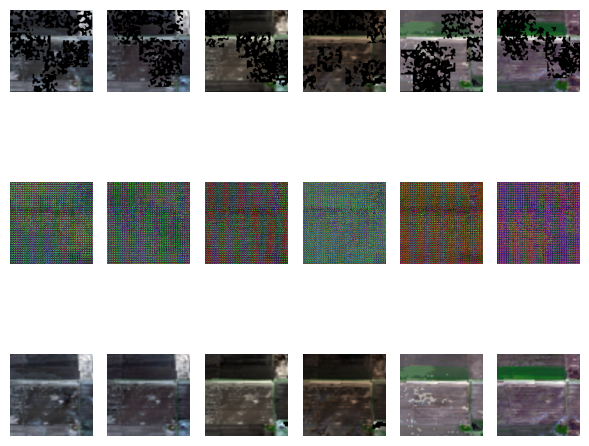

Epoch 1, Train loss.: 4.9166e+00


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.3417501..1.7811769].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0891688..1.9670289].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.321232..1.6327721].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.3414701..1.9171418].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.2751637..1.990739].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.3760146..2.4884093].


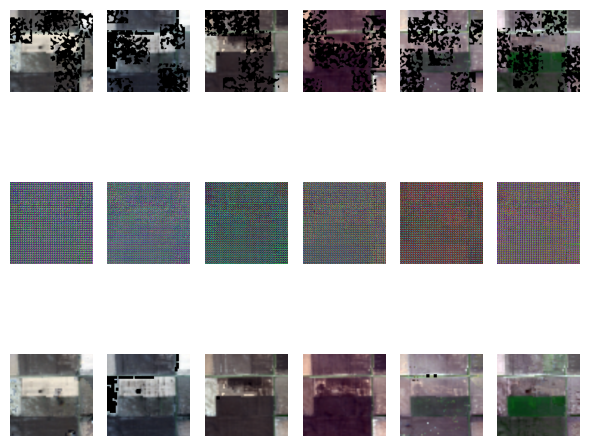

Epoch 2, Train loss.: 3.3001e+00


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.73693..1.3522193].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.55521774..1.52896].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.672769..1.3038694].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.63887423..1.275642].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.6277837..1.6099313].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.86667484..1.6449537].


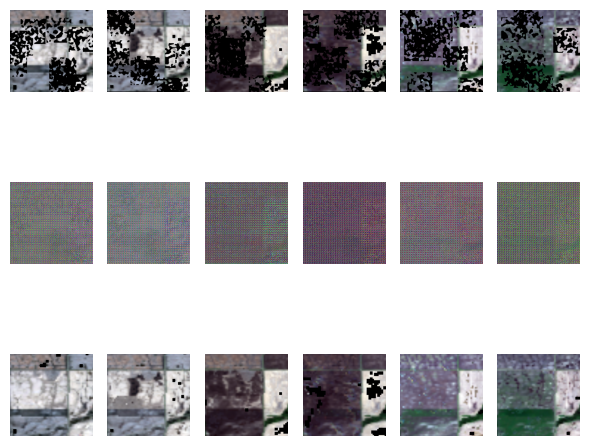

Epoch 3, Train loss.: 2.1726e+00


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.2572831..1.0367231].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13105324..1.1536314].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.2897165..0.98976696].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.20426117..0.96623325].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.31452358..1.0147216].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.3771758..1.0046047].


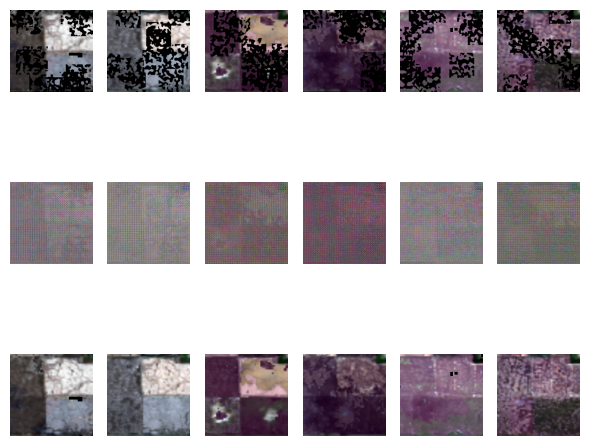

Epoch 4, Train loss.: 1.4862e+00


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.23106638..1.0849279].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.2327203..0.9191153].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.23308516..0.93468523].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.22155385..0.92886835].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.33393362..1.0396693].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17796376..0.95746654].


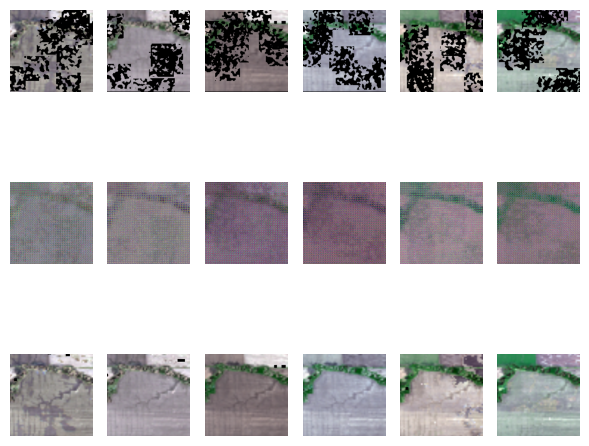

Epoch 5, Train loss.: 1.1704e+00


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.22358038..1.0126565].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16118582..0.9250588].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.29709452..0.8748368].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.32374007..0.7910696].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.39593333..0.9232448].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.24469483..0.88808584].


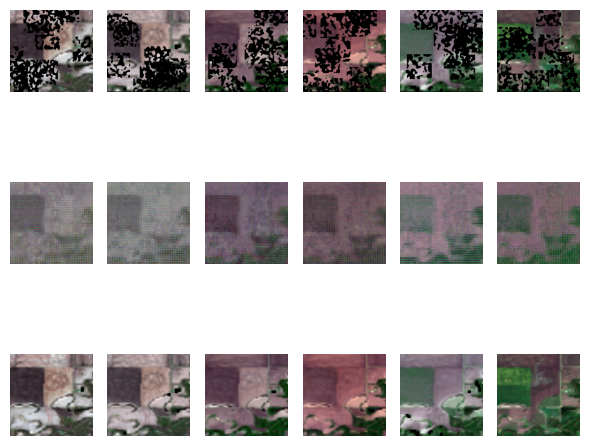

Epoch 6, Train loss.: 1.0539e+00


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.30978101..0.780576].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.14561498..0.740824].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.382974..0.7169195].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.269633..0.70025074].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.27079815..0.75698227].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.30460382..0.6939067].


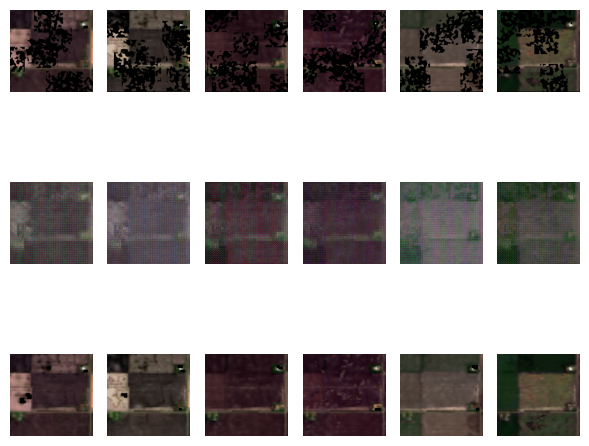

Epoch 7, Train loss.: 9.6017e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.3796659..0.6696913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.32290152..0.5862796].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.43118423..0.68302894].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.38077655..0.70995116].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.34747463..0.764772].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.44828865..0.6089976].


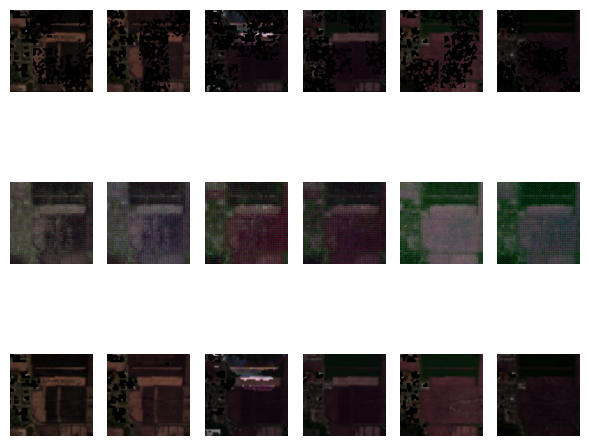

Epoch 8, Train loss.: 9.2417e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.036211334..0.9118344].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09715383..0.71519417].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.14659335..0.69499195].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.12890796..0.6216417].


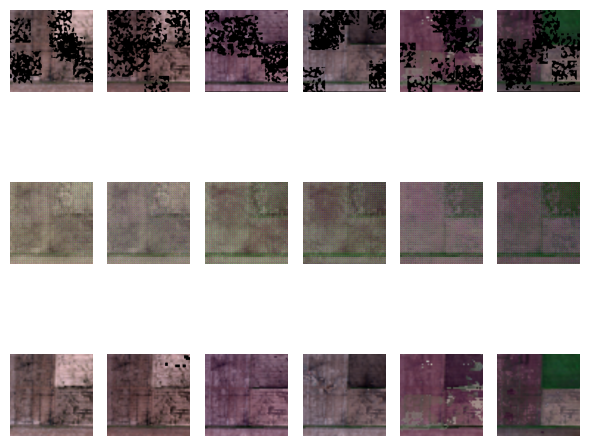

Epoch 9, Train loss.: 8.4794e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.18360235..0.8783016].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.040011298..0.8781539].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.12628025..0.78805214].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10545366..0.8122958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.20565571..0.84274143].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.096295856..0.7909833].


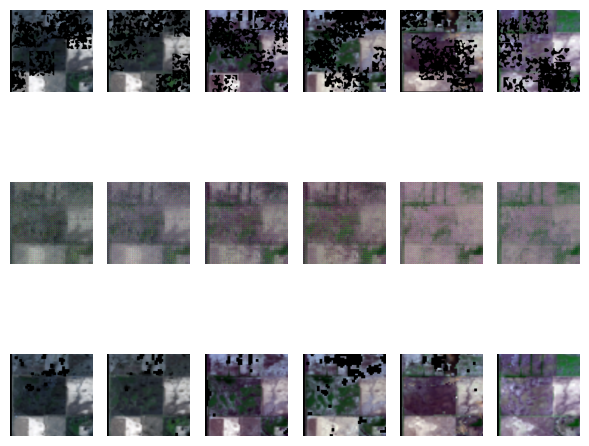

Epoch 10, Train loss.: 8.2522e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.024483643..0.7892045].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.082125895..0.7391295].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07371007..0.7268447].


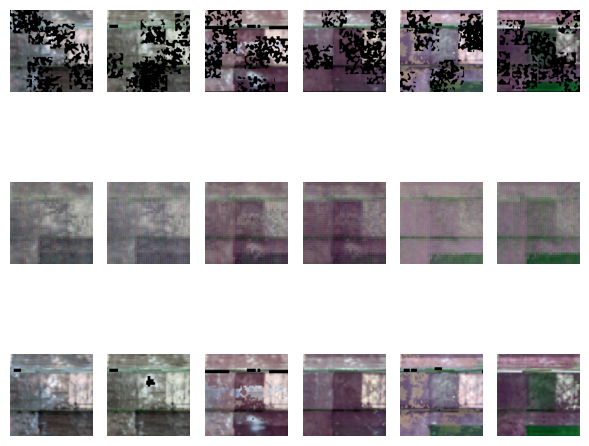

Epoch 11, Train loss.: 7.8937e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.048958667..0.851284].


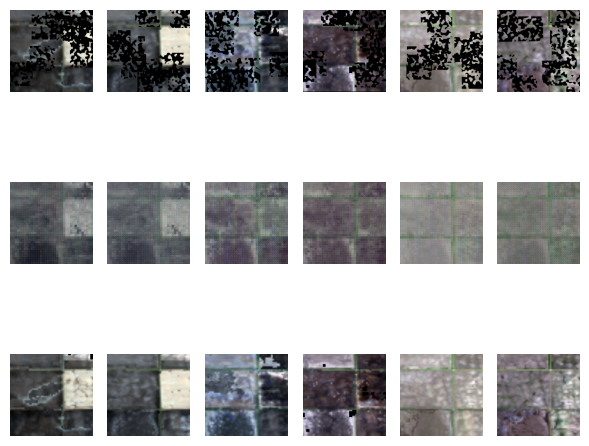

Epoch 12, Train loss.: 7.6922e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09162111..0.95844465].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.043937597..0.9717779].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.14695103..0.7636013].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.15681504..0.8249348].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13431162..0.9544503].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.172892..0.8395063].


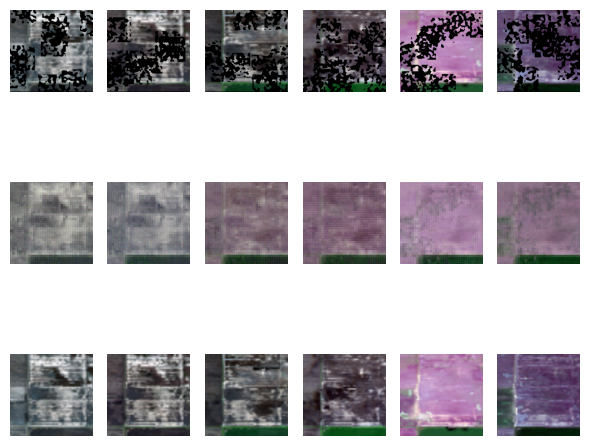

Epoch 13, Train loss.: 7.5615e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1409915..0.61647683].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.15017992..0.57581437].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11079796..0.45773914].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1588011..0.4392496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10108756..0.59943914].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1343826..0.5303265].


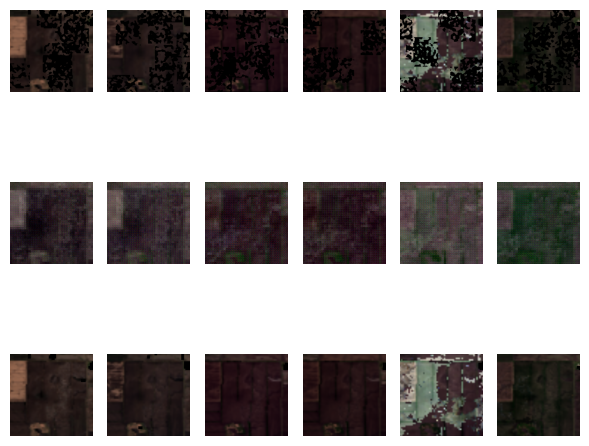

Epoch 14, Train loss.: 7.3281e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09160491..0.9145537].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10806364..0.9411482].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1485185..0.8547793].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.21198331..0.76003474].


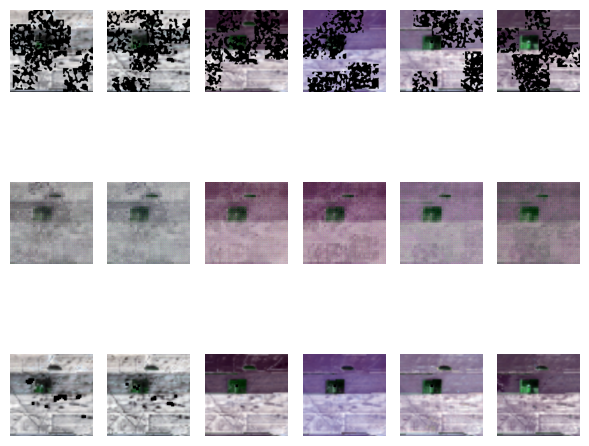

Epoch 15, Train loss.: 7.1960e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.025365753..0.8337375].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0032722815..0.8211787].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.22754653..0.5560241].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.14177679..0.5378755].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17368072..0.7161631].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13706423..0.608955].


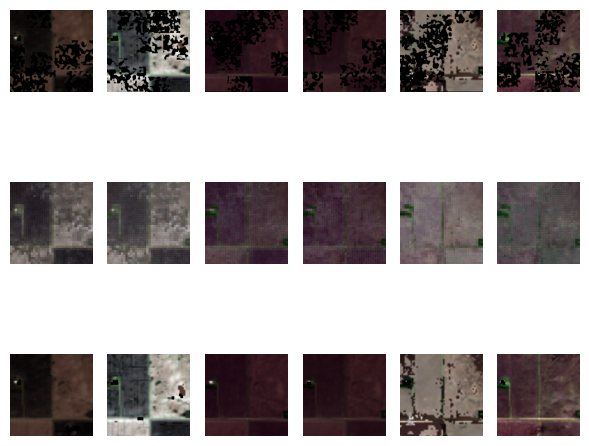

Epoch 16, Train loss.: 7.1766e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.032749247..0.9294083].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.14210309..0.86893123].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13007583..0.8207988].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10988819..0.87430924].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06574954..0.77786386].


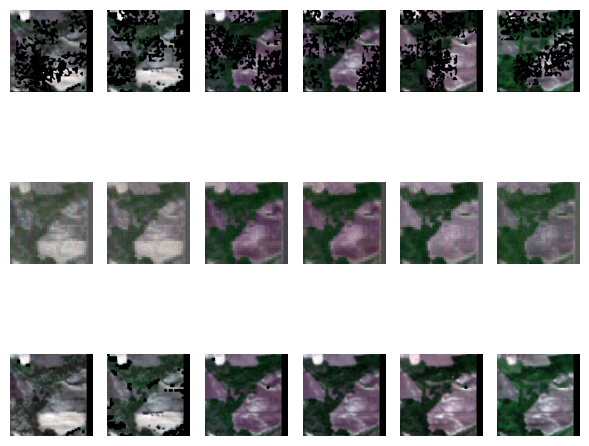

Epoch 17, Train loss.: 7.0537e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.050432295..0.84428316].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.036072455..0.8240792].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.061639085..0.88642627].


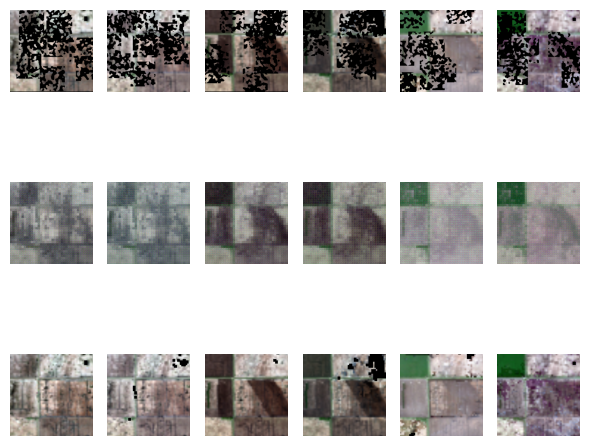

Epoch 18, Train loss.: 6.9058e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.043272942..0.80801874].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.043659993..0.5890521].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.044175927..0.62354225].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.03421746..0.6497111].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08227169..0.52167606].


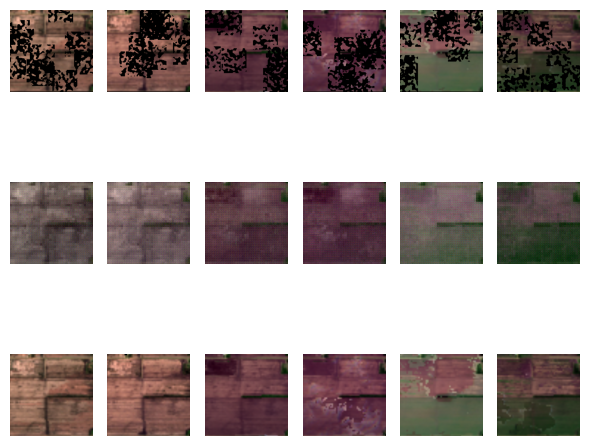

Epoch 19, Train loss.: 6.8220e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.028988266..0.99699444].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06535764..0.8982435].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05363014..0.9224797].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.029027909..1.032239].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.083513536..0.9186741].


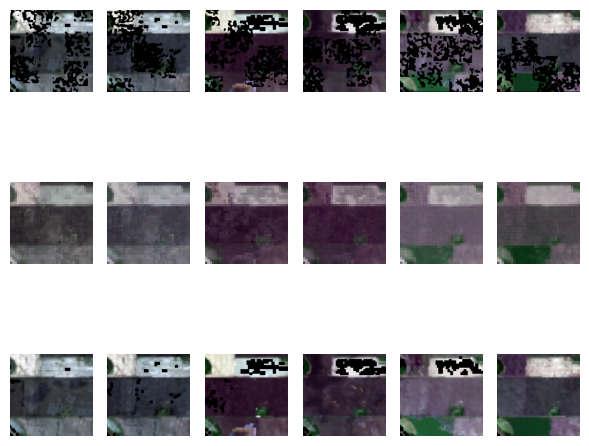

Epoch 20, Train loss.: 6.7391e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10817176..0.81008446].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08371287..0.8182945].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1498897..0.8336065].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13405912..0.7344694].


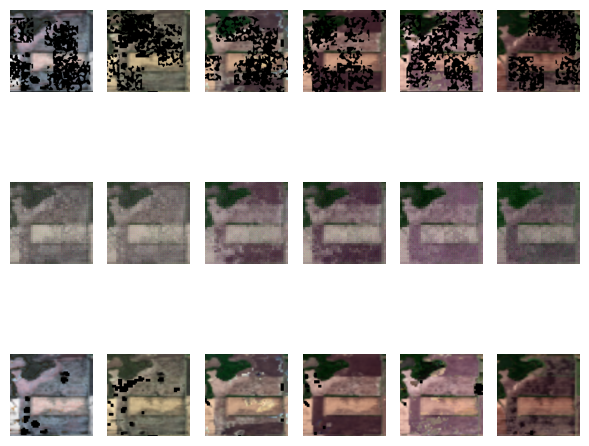

Epoch 21, Train loss.: 6.6688e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.020591063..0.9374071].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.007320966..0.98360395].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.087347336..0.74558276].


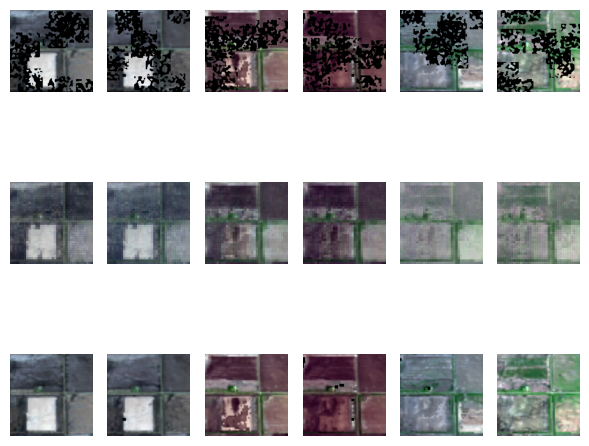

Epoch 22, Train loss.: 6.5965e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.12094057..1.1135098].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.1407532..1.0682714].


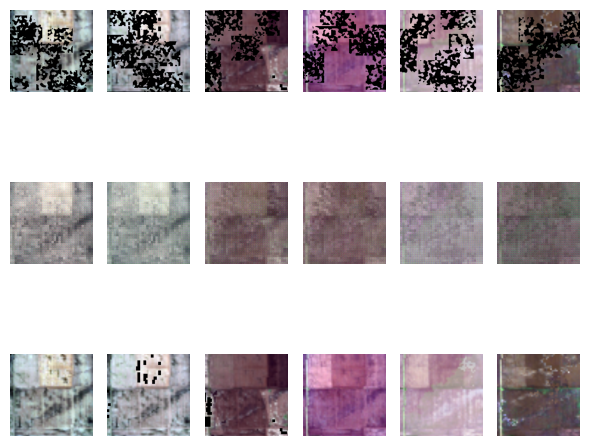

Epoch 23, Train loss.: 6.4802e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.10792983..1.0496575].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08235581..1.0424783].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06346456..1.0744298].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16183145..0.9386241].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.14710231..0.83783144].


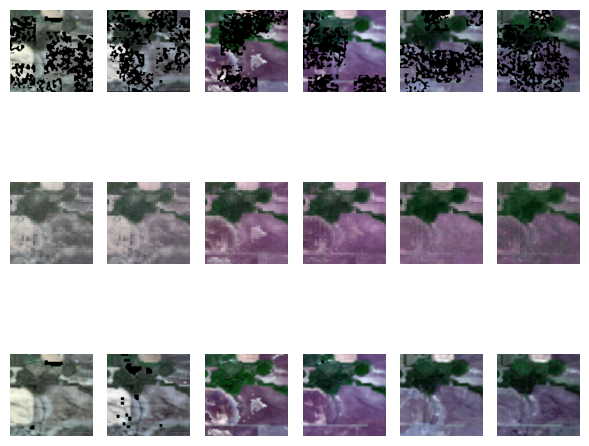

Epoch 24, Train loss.: 6.4368e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.01044737..0.94222397].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05334306..0.8424896].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.008579241..0.91456074].


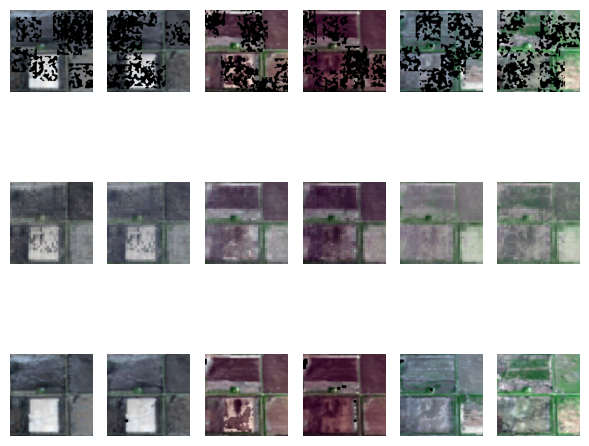

Epoch 25, Train loss.: 6.3944e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.019271389..0.8371873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.020746164..0.7835825].


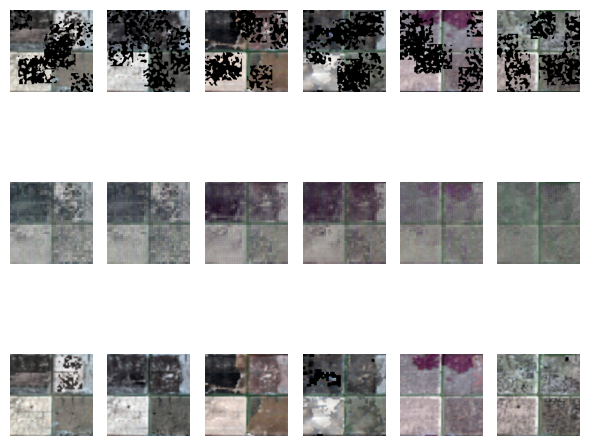

Epoch 26, Train loss.: 6.6017e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.020030327..1.0348107].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05063627..0.8578305].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.024946913..0.7353036].


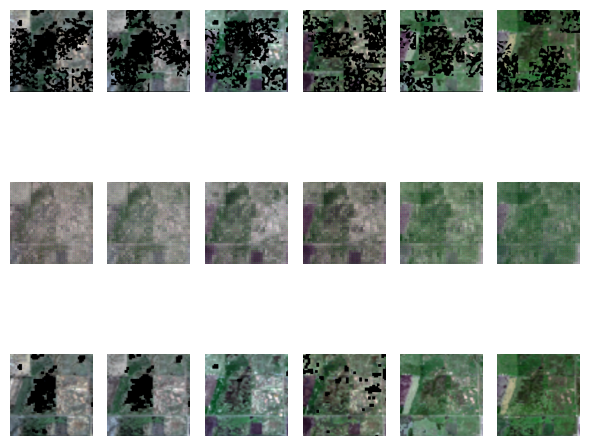

Epoch 27, Train loss.: 6.2948e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.03390171..0.8856086].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07455784..0.9410344].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.03156809..0.8471674].


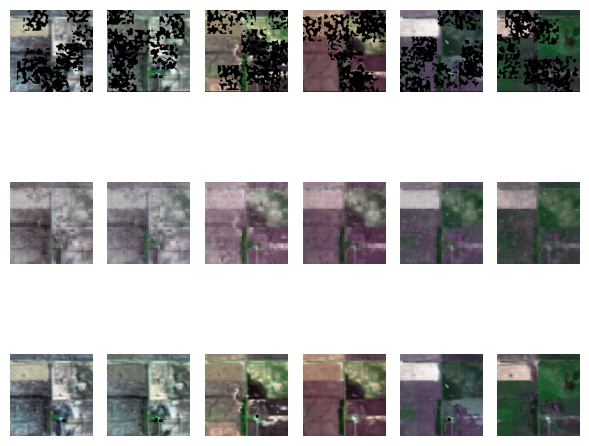

Epoch 28, Train loss.: 6.2644e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11349795..1.2071568].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17049235..1.1774563].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.18552262..0.99732226].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.2080269..0.9987422].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.21978295..1.1369925].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.23125573..1.1407969].


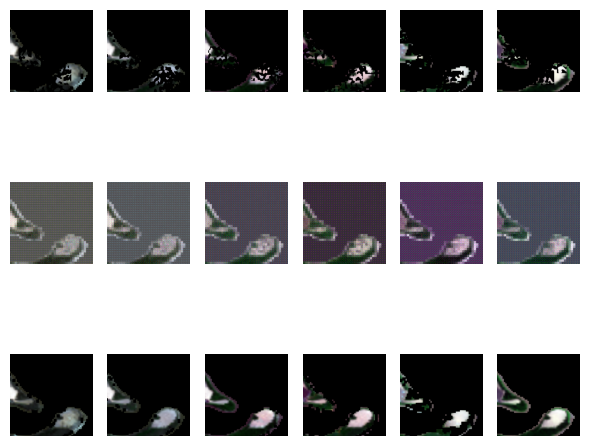

Epoch 29, Train loss.: 6.1698e-01


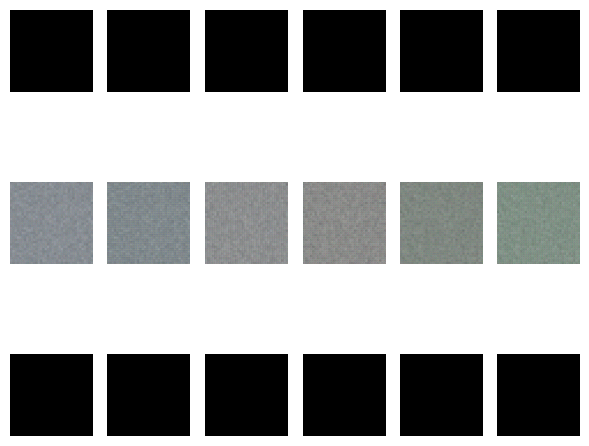

Epoch 30, Train loss.: 6.1430e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.012807228..0.96625596].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06550243..0.93065965].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.057031494..0.926972].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.12159507..0.94091785].


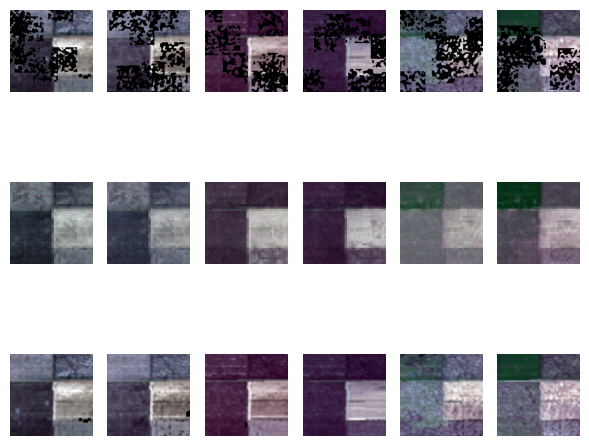

Epoch 31, Train loss.: 6.1200e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.025775231..0.7504584].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04970613..0.7327201].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04129772..0.7444961].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.076193474..0.60941416].


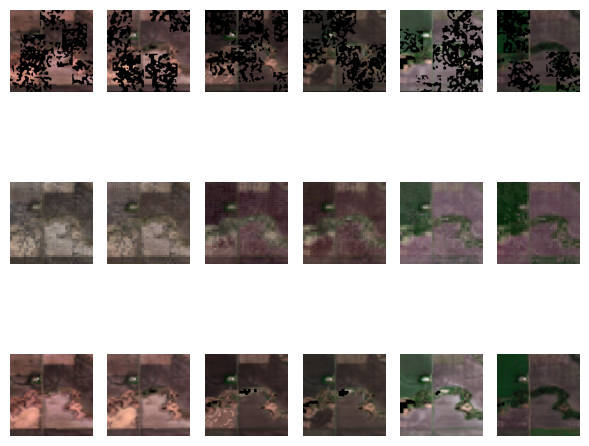

Epoch 32, Train loss.: 6.0198e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0023535045..0.86215353].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.017014418..0.72605073].


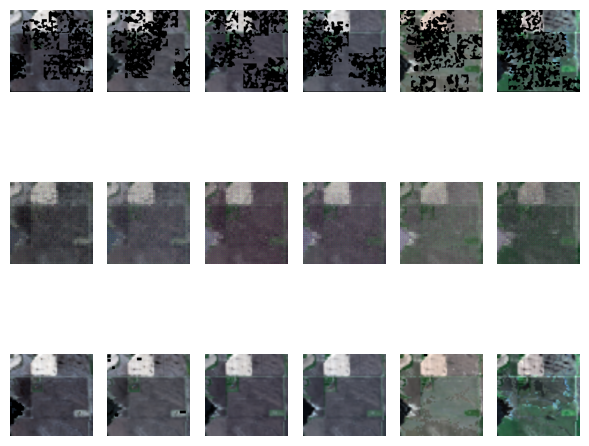

Epoch 33, Train loss.: 5.9758e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06446849..0.90249].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.01829078..0.9082067].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07471462..0.83961666].


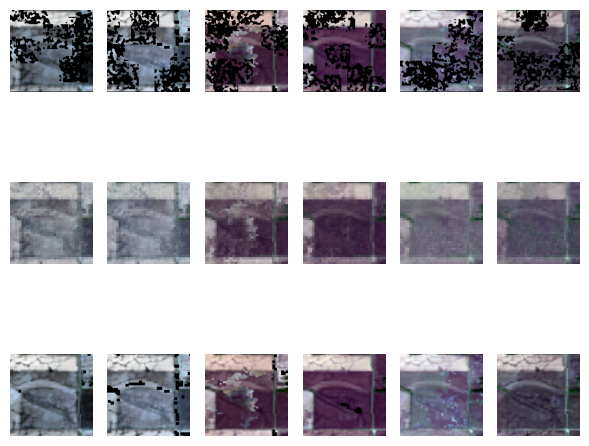

Epoch 34, Train loss.: 5.9303e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07116398..0.88378614].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.020799614..0.8038502].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07656373..0.60494703].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.03135282..0.64967513].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10978458..0.5092189].


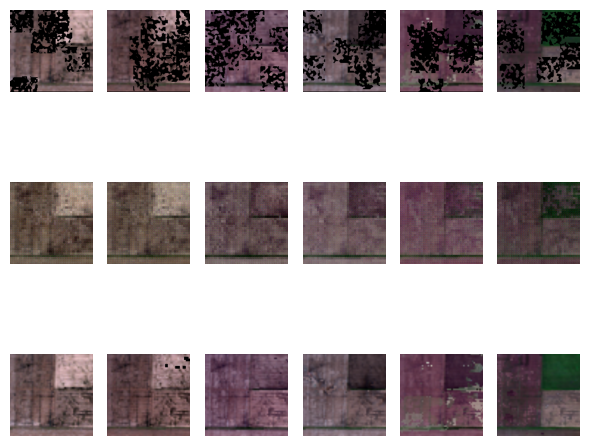

Epoch 35, Train loss.: 5.8809e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07389894..1.0282617].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07758318..0.65760225].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.006530067..0.79741096].


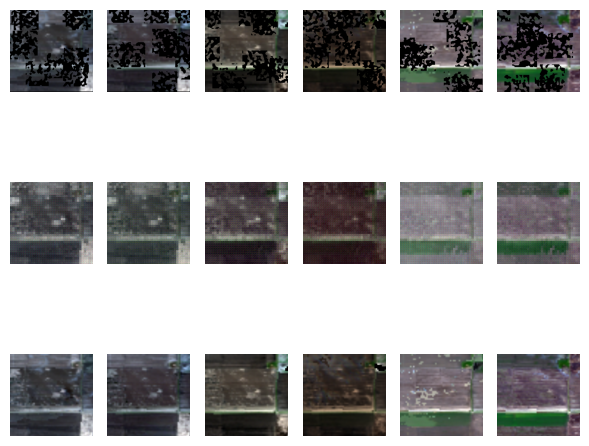

Epoch 36, Train loss.: 5.8172e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08264941..0.8677227].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07715891..0.7886408].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.01642873..0.8200974].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.035334118..0.76283944].


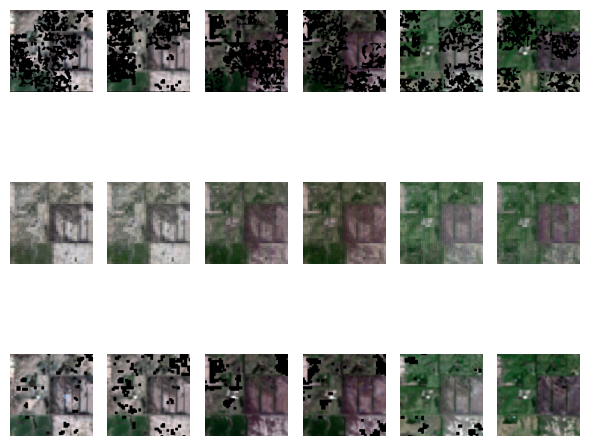

Epoch 37, Train loss.: 5.8117e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.114991195..0.899502].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.102279454..0.9226769].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.037962772..0.96140814].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0048646536..0.86567473].


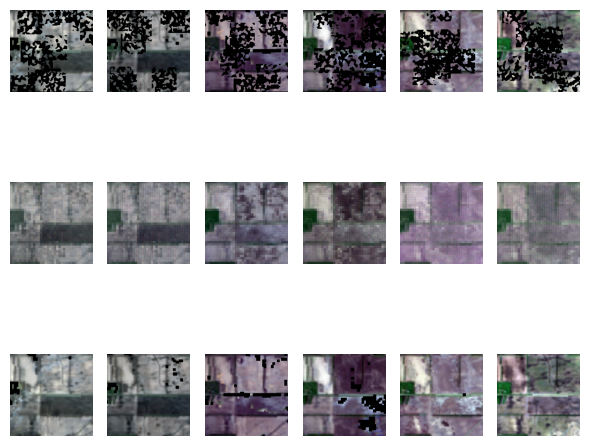

Epoch 38, Train loss.: 5.7320e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.013073889..0.7627951].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.000107177824..0.8219779].


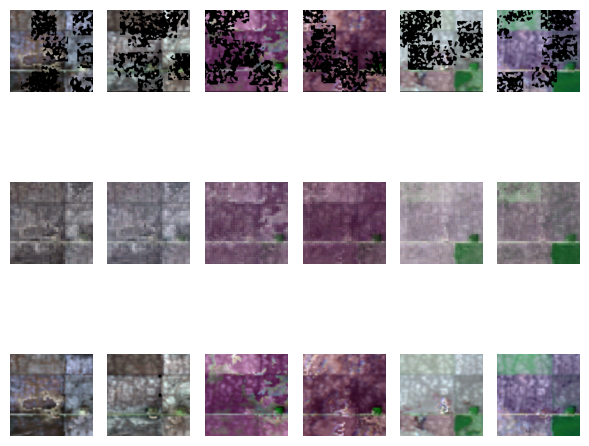

Epoch 39, Train loss.: 5.7309e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05856249..0.8867661].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.005294819..0.94104344].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10582188..0.86337876].


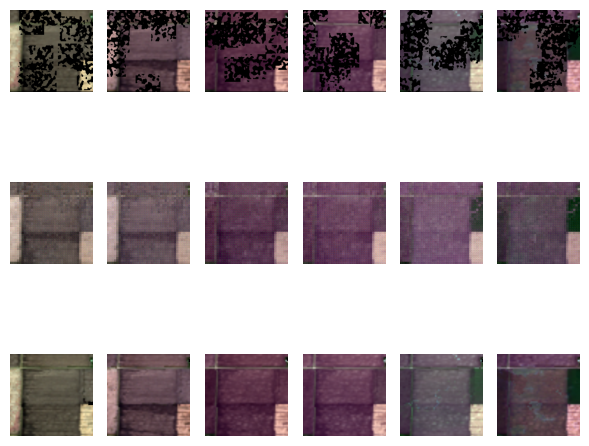

Epoch 40, Train loss.: 5.6726e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.036111493..0.8891587].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.056702796..0.8364279].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08767777..0.7116034].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.121219255..0.6589921].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0927287..0.73005366].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.091423444..0.6179822].


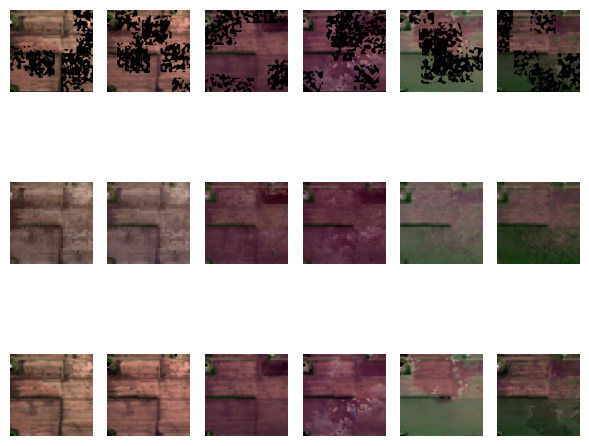

Epoch 41, Train loss.: 5.6515e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.016945517..1.0170553].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0061868345..0.9857937].


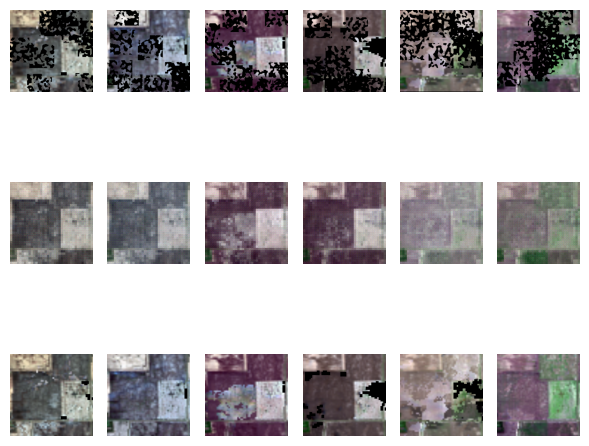

Epoch 42, Train loss.: 5.6310e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10411268..0.66539747].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.015056876..0.6510921].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13755912..0.6794963].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.12734248..0.7924397].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1202005..0.6189861].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06871861..0.6015508].


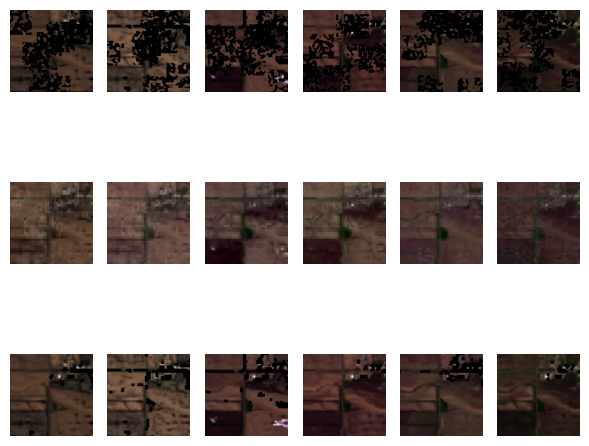

Epoch 43, Train loss.: 5.5818e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0019671486..1.0485792].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.033568334..0.98700434].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.028345121..0.9032894].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.094287604..0.8515563].


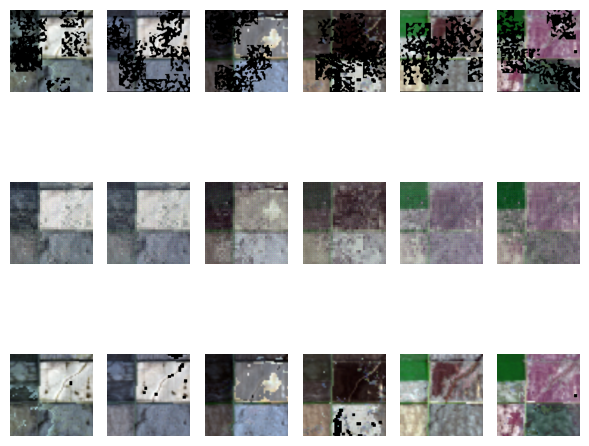

Epoch 44, Train loss.: 5.5648e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.050255813..0.96320784].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06653..0.91202056].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13054366..0.88882744].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06955502..0.8894646].


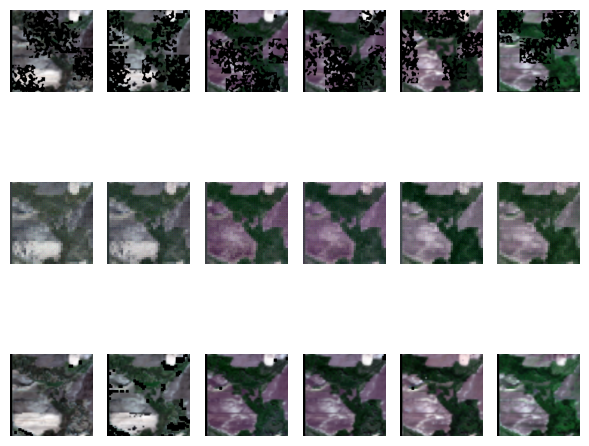

Epoch 45, Train loss.: 5.6763e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.03976919..0.8707784].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.03898071..0.83666307].


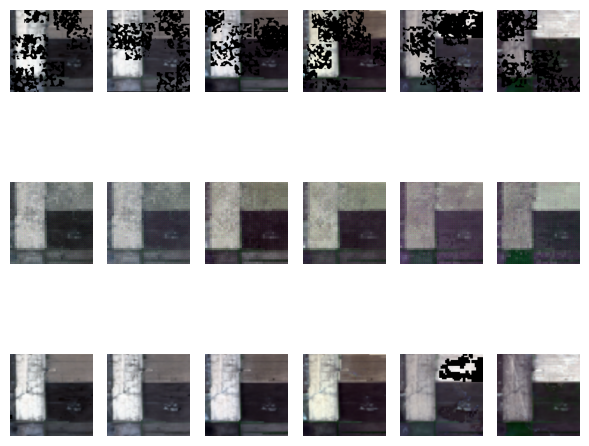

Epoch 46, Train loss.: 5.4899e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.048050962..0.95037144].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.056463774..0.9681627].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07155524..0.93905795].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054677695..0.85999066].


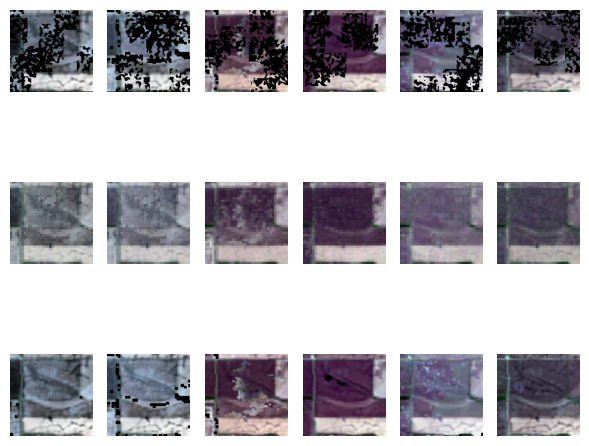

Epoch 47, Train loss.: 5.4433e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06414063..0.8410307].


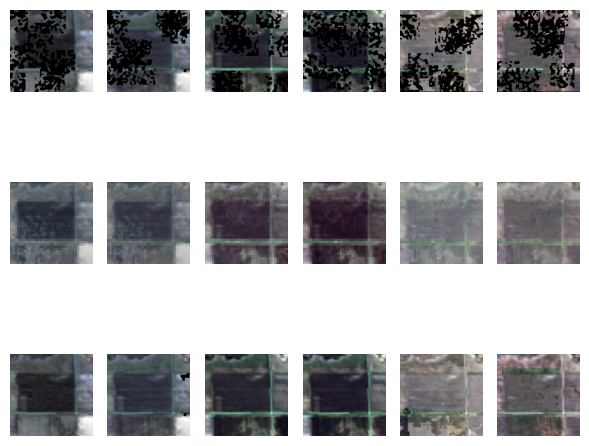

Epoch 48, Train loss.: 5.4269e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08220124..0.7437502].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07158279..0.7711167].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.19368964..0.6047252].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09524072..0.6660486].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09386952..0.6945249].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.088439666..0.61394954].


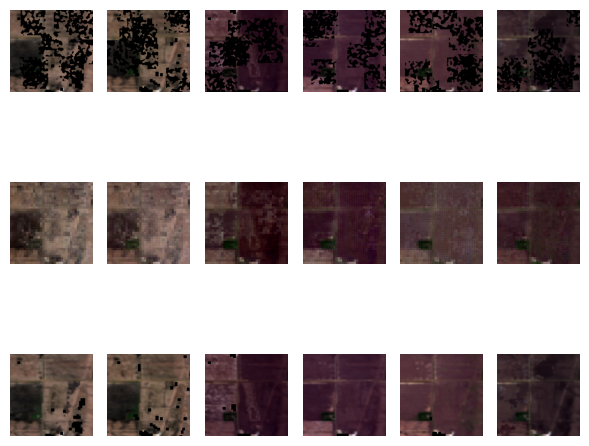

Epoch 49, Train loss.: 5.4076e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.037574705..0.81536347].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.014779976..0.774441].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05908241..0.81760466].


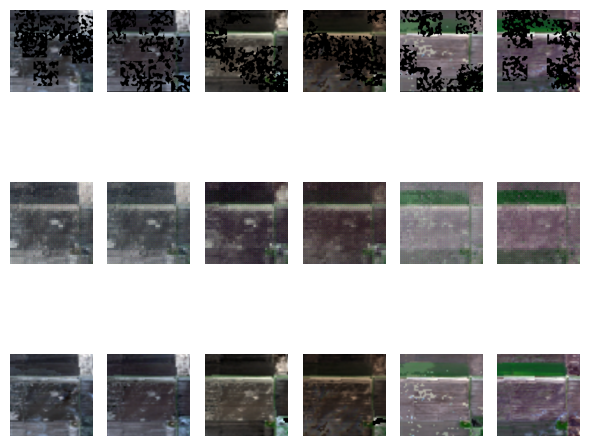

Epoch 50, Train loss.: 5.3643e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.079442345..0.5982876].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.087520055..0.5982796].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.061767813..0.62866056].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1359225..0.5197336].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10013026..0.45012042].


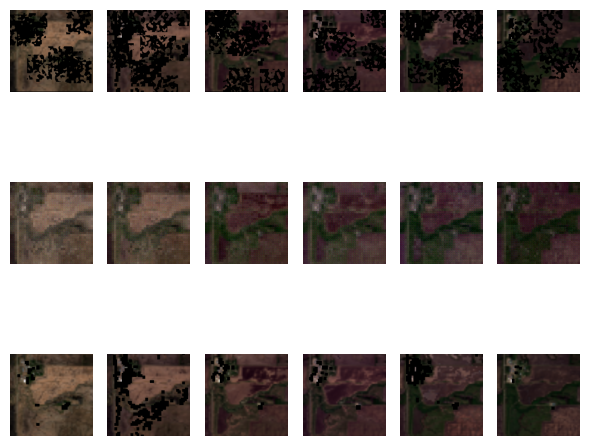

Epoch 51, Train loss.: 5.3423e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.009801702..0.91671014].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.021178925..0.9156348].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0499618..0.83041334].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08357621..0.75681317].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06507923..0.76800734].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07299986..0.7392375].


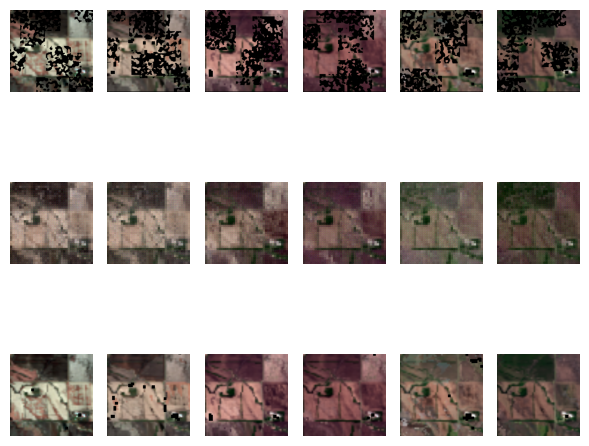

Epoch 52, Train loss.: 5.3181e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11991457..0.7311171].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.073954776..0.6384981].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13069382..0.5756041].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13014819..0.54511404].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.049929786..0.723273].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.12948535..0.543862].


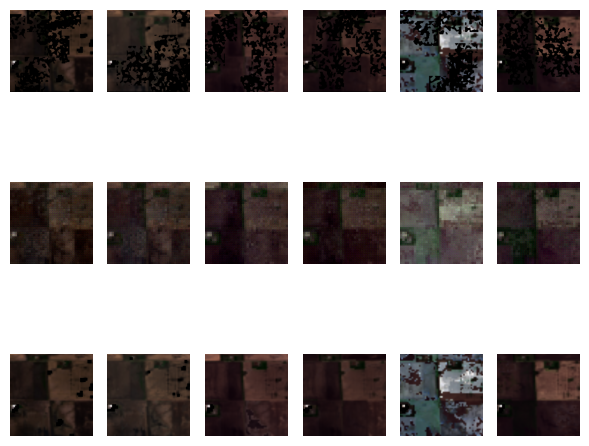

Epoch 53, Train loss.: 5.2940e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.056332394..0.8874211].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.025203126..0.8310431].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.061209377..0.8078605].


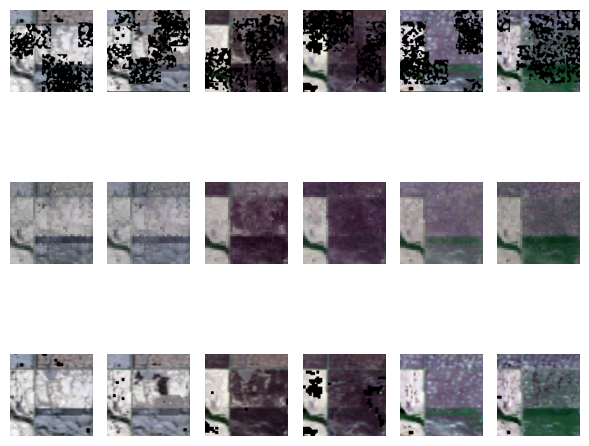

Epoch 54, Train loss.: 5.2772e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.015750676..0.9906238].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.051999383..0.9866531].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06632014..0.9487046].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05271018..0.89957273].


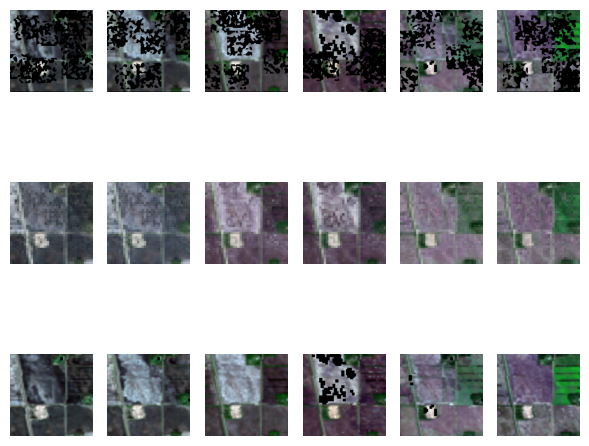

Epoch 55, Train loss.: 5.2792e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0050197556..0.9463498].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.029336806..0.92046267].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07417299..0.7992393].


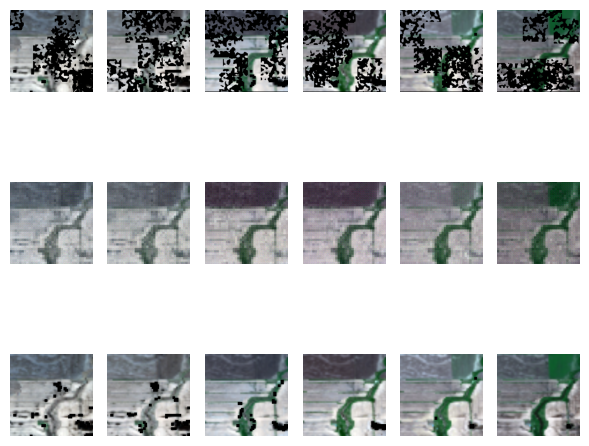

Epoch 56, Train loss.: 5.2411e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.011154221..0.991285].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0014253781..1.0118119].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04375638..0.88223106].


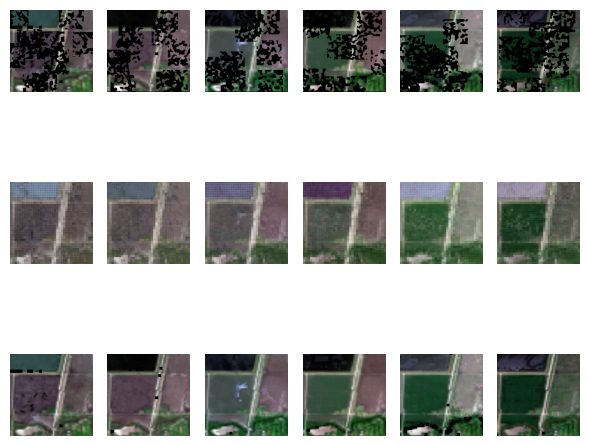

Epoch 57, Train loss.: 5.1548e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.023651715..1.0400678].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0064188265..0.89240247].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.033477..0.8840902].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.041401777..0.93243784].


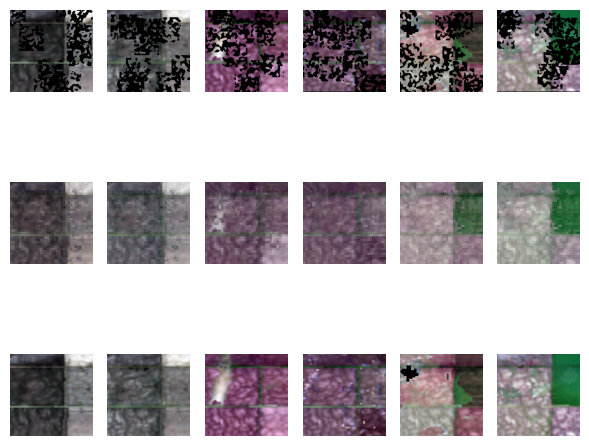

Epoch 58, Train loss.: 5.1873e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.030866995..0.933942].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.00795961..0.9555359].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.015931498..1.0087527].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0012114635..1.0568585].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06683422..0.96271384].


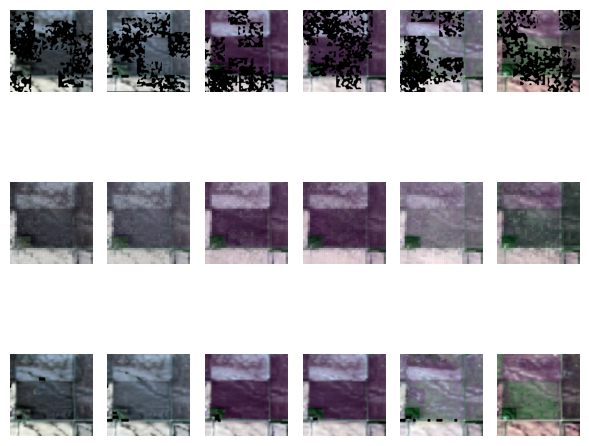

Epoch 59, Train loss.: 5.1751e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.02323721..0.6384194].


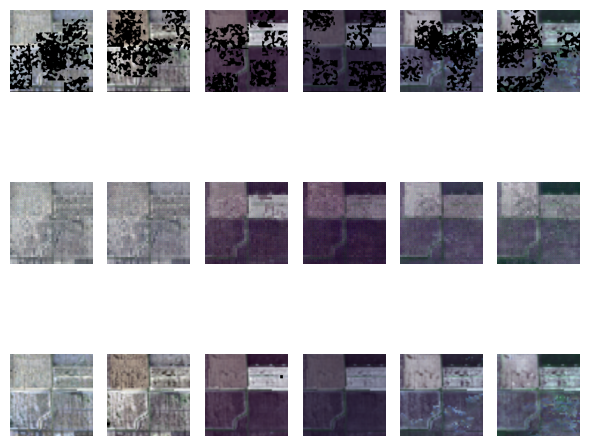

Epoch 60, Train loss.: 5.4501e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0019405097..0.8464918].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.072201476..0.67108583].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.032127656..0.88480586].


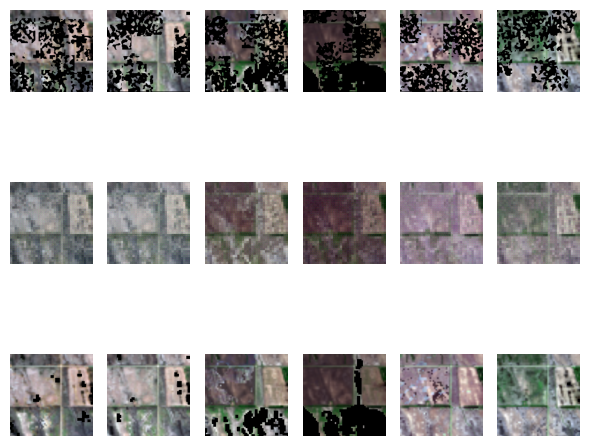

Epoch 61, Train loss.: 5.2787e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08450696..0.96571743].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0834947..0.94230926].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11154775..0.8829891].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.15768068..0.70958906].


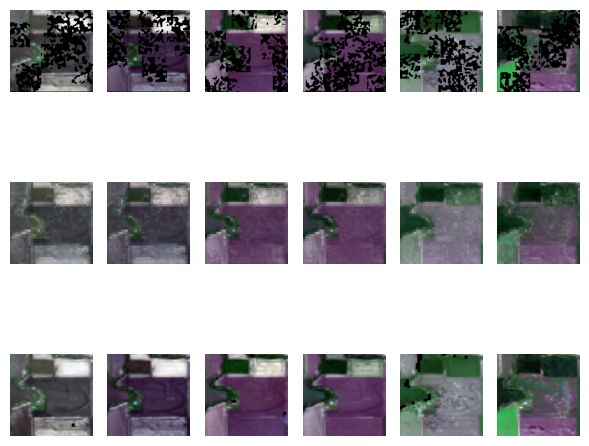

Epoch 62, Train loss.: 5.0908e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.029861946..0.7253477].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05261855..0.716717].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11892075..0.91630787].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11149081..0.65342396].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.15661018..0.75121576].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10505785..0.47737816].


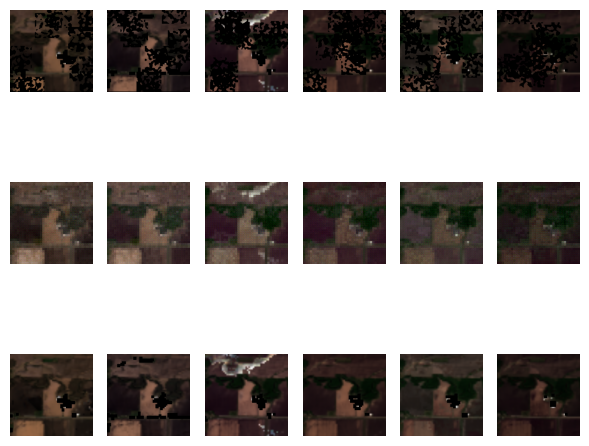

Epoch 63, Train loss.: 5.0793e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05459666..0.99610245].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.051447608..1.0056139].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.026811792..0.9571638].


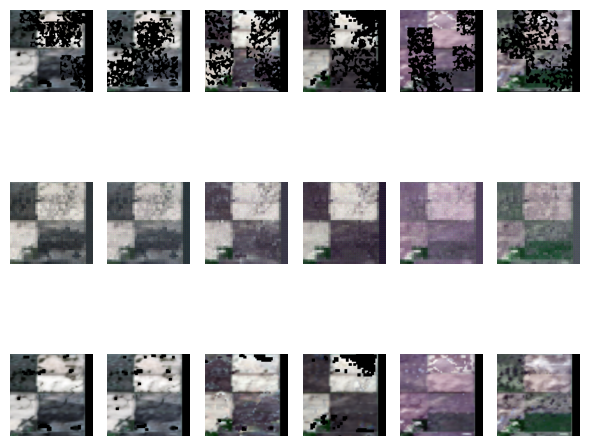

Epoch 64, Train loss.: 5.0739e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.029843118..0.878697].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.039703783..0.95141757].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.075909995..1.0412531].


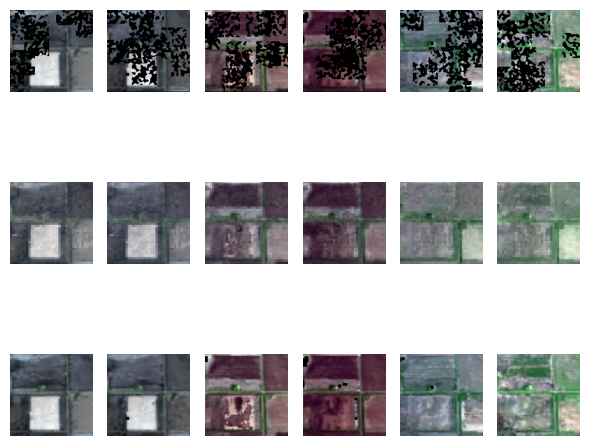

Epoch 65, Train loss.: 5.0508e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04629328..0.9300089].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.080646165..0.9710728].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.15643077..0.8140113].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.036122426..0.885412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.116453074..0.8030785].


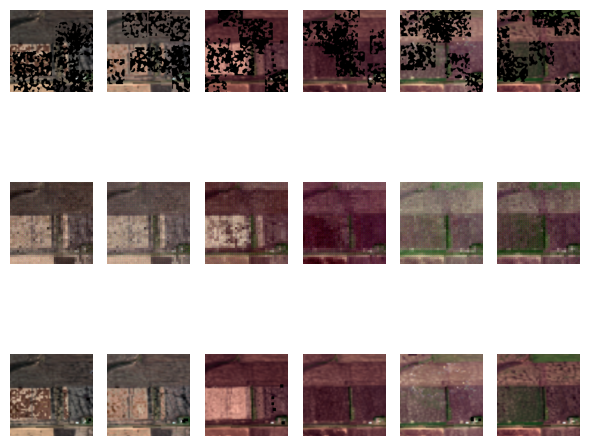

Epoch 66, Train loss.: 5.0105e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06484727..0.7881995].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07036927..0.806955].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06789085..0.8274288].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.017168771..0.70019335].


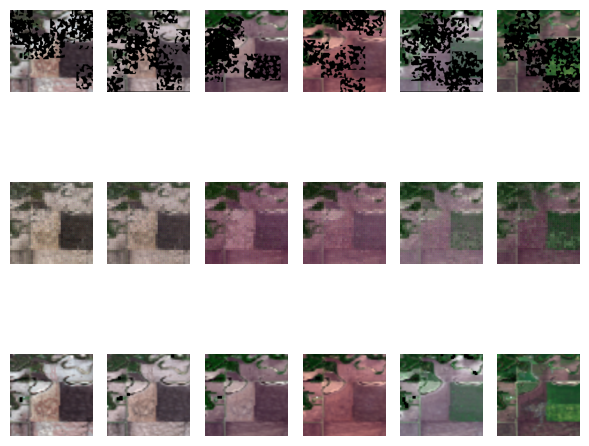

Epoch 67, Train loss.: 5.0105e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.02773123..0.94416606].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.043964528..0.96695626].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.025751162..0.88077295].


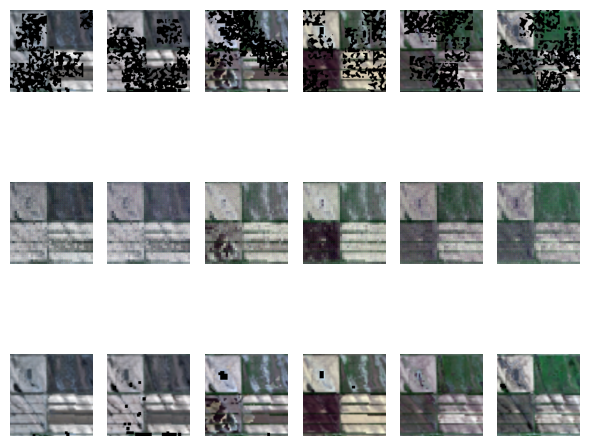

Epoch 68, Train loss.: 5.3077e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.022944232..0.9099339].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.033582214..0.8117446].


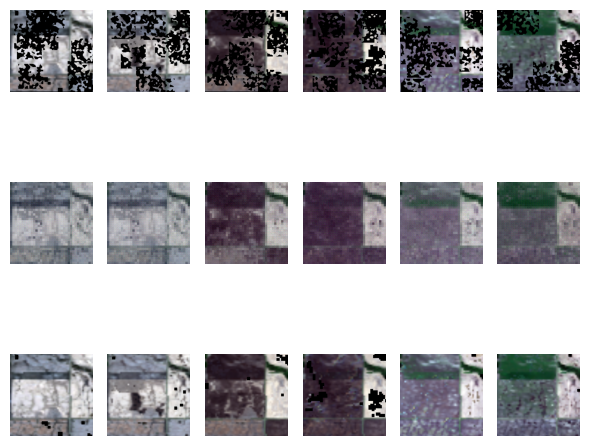

Epoch 69, Train loss.: 4.9828e-01


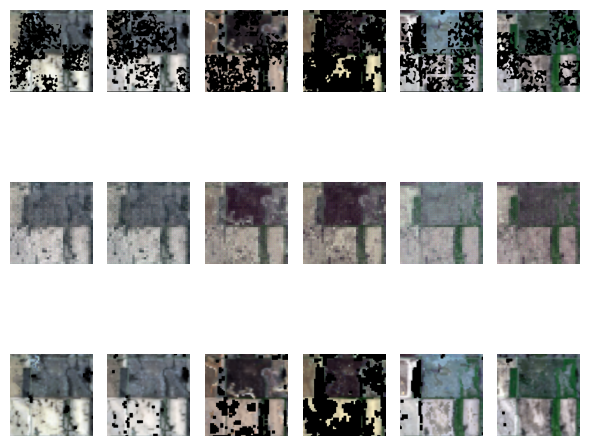

Epoch 70, Train loss.: 5.3481e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.036651887..1.0674196].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.11021381..1.0276668].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.009049673..1.0354904].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.058724713..0.84341663].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.032746743..0.8301075].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0078669265..0.7167747].


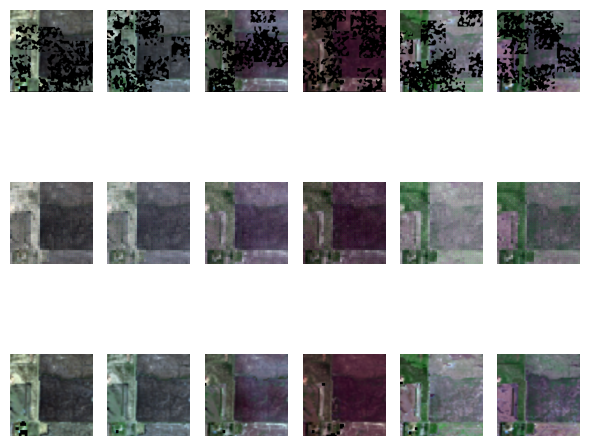

Epoch 71, Train loss.: 4.9405e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.02558415..0.9369308].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.072769046..0.9308825].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13166036..0.9894994].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.122980714..0.94997424].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.036022875..0.9081597].


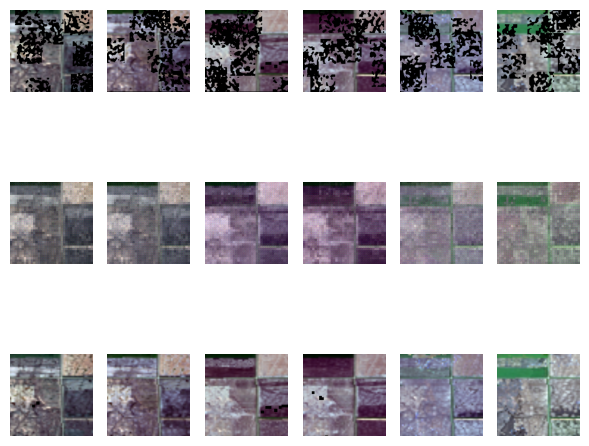

Epoch 72, Train loss.: 4.9299e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.016032401..1.0965827].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.023781197..1.0260093].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.042490307..1.0316005].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.100518234..0.9099002].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054335512..0.6980834].


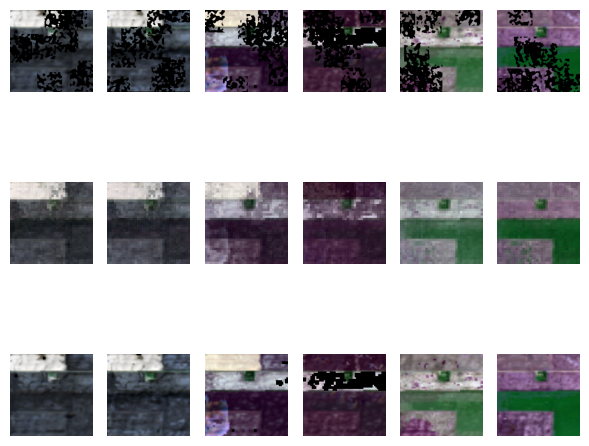

Epoch 73, Train loss.: 4.8936e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.010562245..0.87214184].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.006598537..0.88186383].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.040533975..0.82543194].


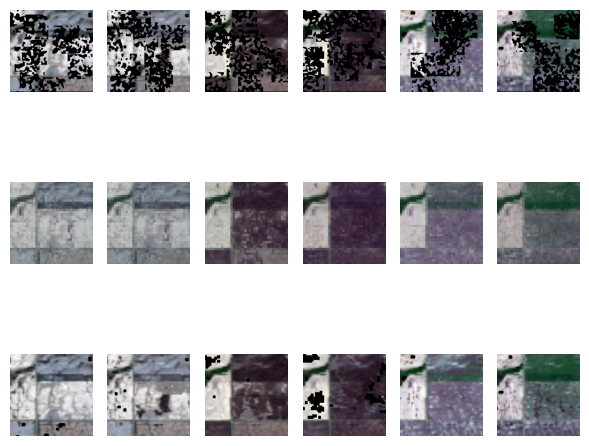

Epoch 74, Train loss.: 4.9154e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.014399493..0.95049304].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05132682..0.92282873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.071139656..0.89102656].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.03746531..0.8665578].


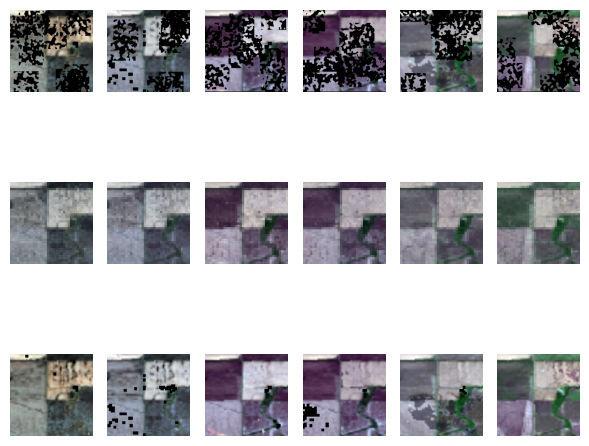

Epoch 75, Train loss.: 4.8616e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.00901836..1.0179554].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054830436..0.88559484].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0012005614..0.92957103].


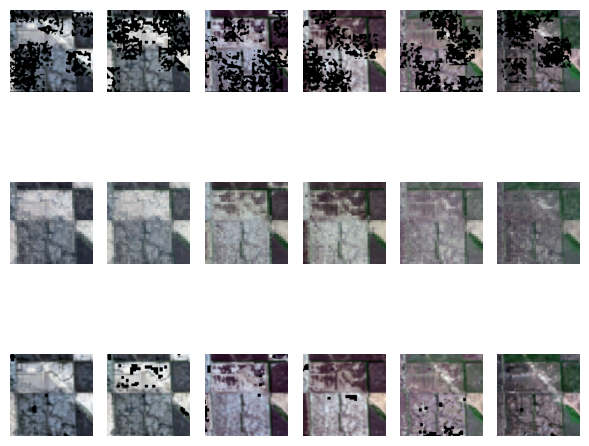

Epoch 76, Train loss.: 4.8524e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.08565451..1.0352073].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.09875917..1.0590025].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.017277865..0.9943387].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.009126575..0.78853273].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07122117..0.8839923].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05025418..0.9335946].


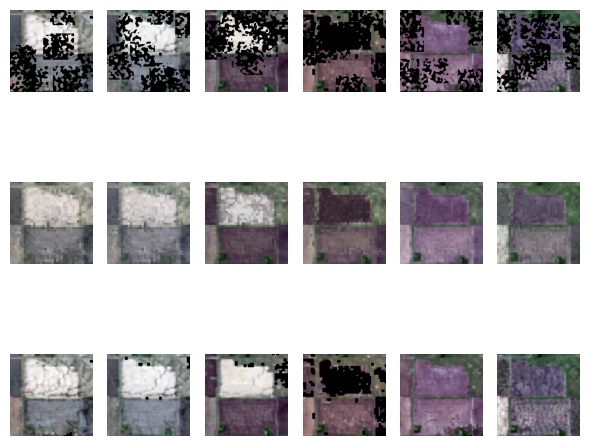

Epoch 77, Train loss.: 4.8618e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11816398..0.8497224].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.104327284..0.75896937].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11768184..0.8389088].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08663224..0.6190233].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.14889318..0.613169].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.12775064..0.69692767].


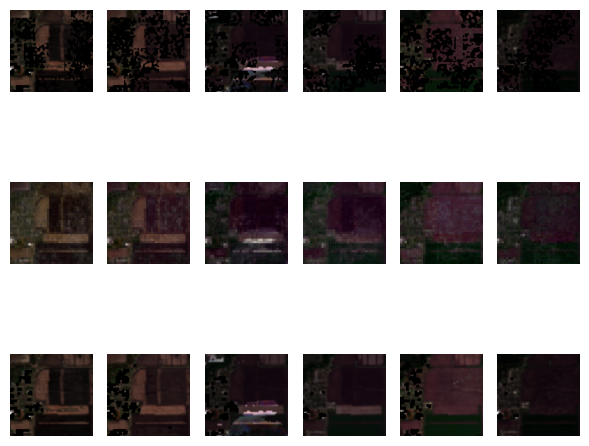

Epoch 78, Train loss.: 4.8783e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0139420815..0.7542408].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.030175313..0.79103106].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09553637..0.89514273].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.15453981..0.49913427].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09164389..0.5753546].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08058215..0.5490569].


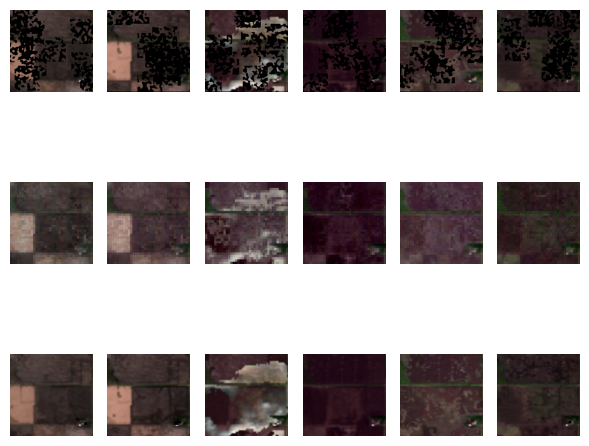

Epoch 79, Train loss.: 4.8172e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.035729736..0.9533069].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0887855..0.8746622].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.039453793..0.8135111].


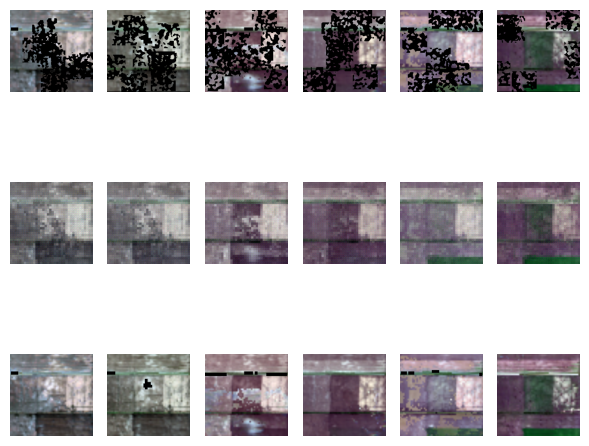

Epoch 80, Train loss.: 4.8258e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.016072068..0.9571022].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06274169..0.9879858].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11129734..0.72120273].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.068966806..0.70103514].


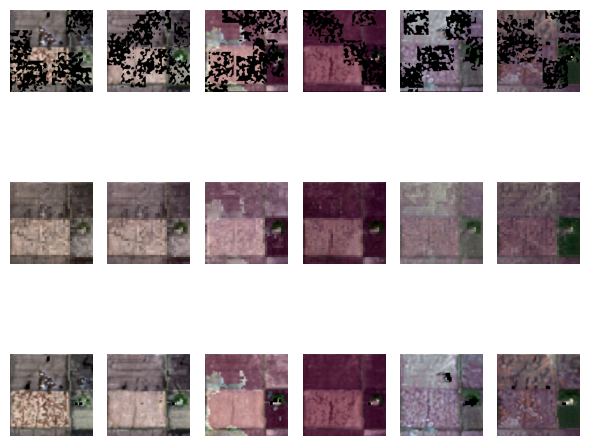

Epoch 81, Train loss.: 5.2020e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.046513807..1.0138141].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06240089..0.72610575].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.010467467..0.8438714].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.00076560525..0.81397647].


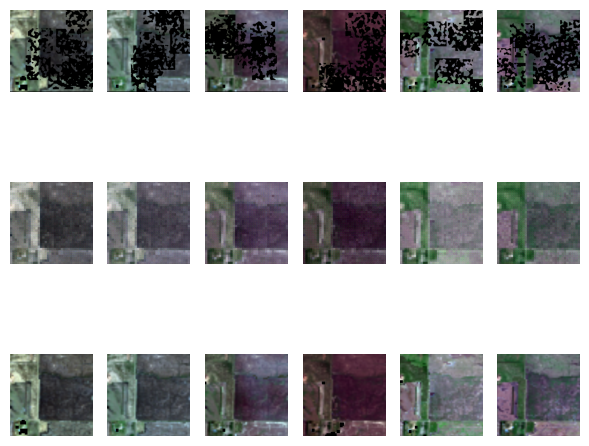

Epoch 82, Train loss.: 4.8162e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.049899..1.0128367].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.014897914..1.0098451].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.024059584..0.95562].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07481583..0.9332478].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06997914..0.9726873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.043636218..0.9489963].


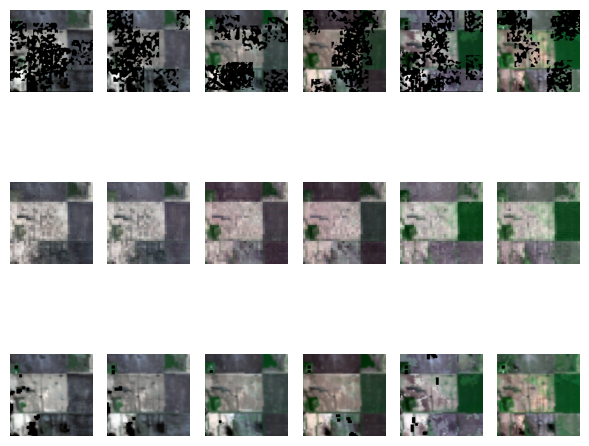

Epoch 83, Train loss.: 4.7532e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.11045739..1.0245415].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0033014177..0.97388744].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.030337457..1.0268397].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05070841..0.9793542].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.058571674..0.9114628].


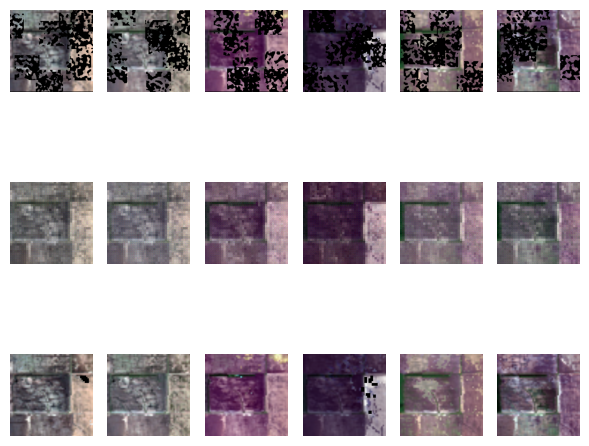

Epoch 84, Train loss.: 4.7888e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0036663592..0.8929783].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.119566575..0.82630855].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08866042..0.7834577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.045351833..0.8452126].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.048893522..0.83780444].


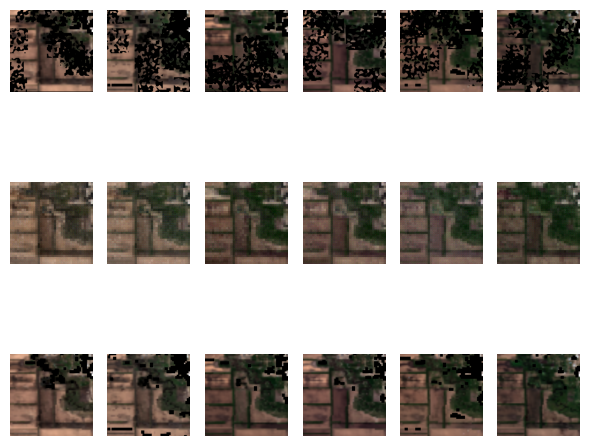

Epoch 85, Train loss.: 4.7578e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08885344..0.8394494].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06787659..0.8734937].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0014476333..0.7700071].


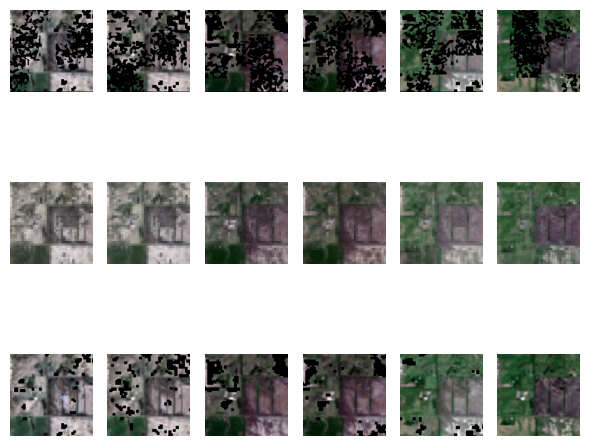

Epoch 86, Train loss.: 4.7316e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09061896..0.7235941].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08768679..0.67261225].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11417864..0.839479].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.14847861..0.5244429].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1286211..0.50539345].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1395667..0.43957043].


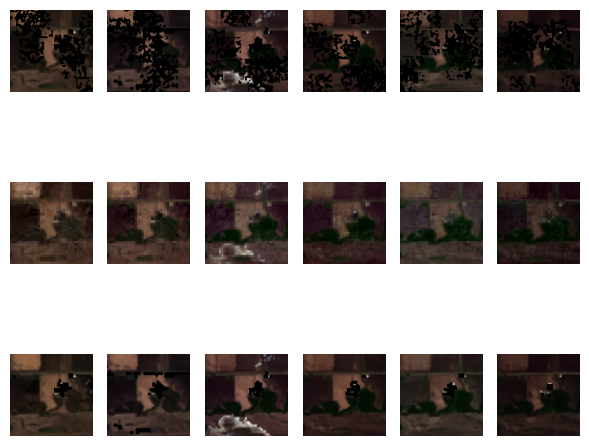

Epoch 87, Train loss.: 4.7437e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.03109926..0.8566927].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.02853042..0.96970505].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.004939156..1.0151972].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.033700477..0.9212476].


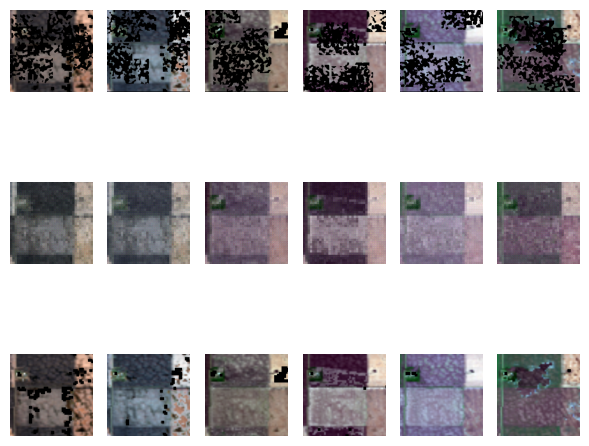

Epoch 88, Train loss.: 4.7671e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0022931076..1.0079578].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.011111665..0.9524532].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09475433..0.96129745].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11717557..0.946561].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.081548914..0.90505224].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054600414..0.792932].


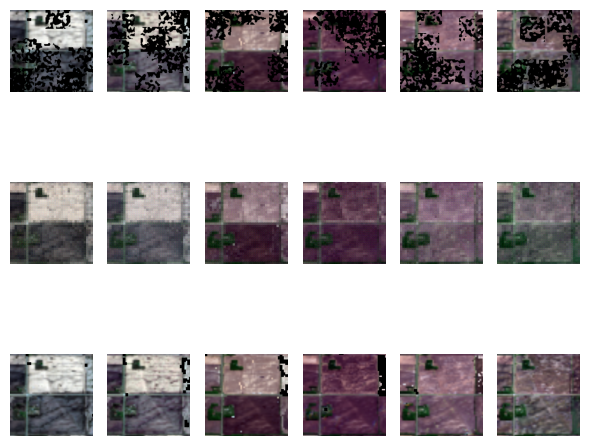

Epoch 89, Train loss.: 4.7125e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.04839948..1.0929933].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07115718..1.1310931].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09733596..1.0269088].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11783261..0.9893247].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.041658472..0.88358915].


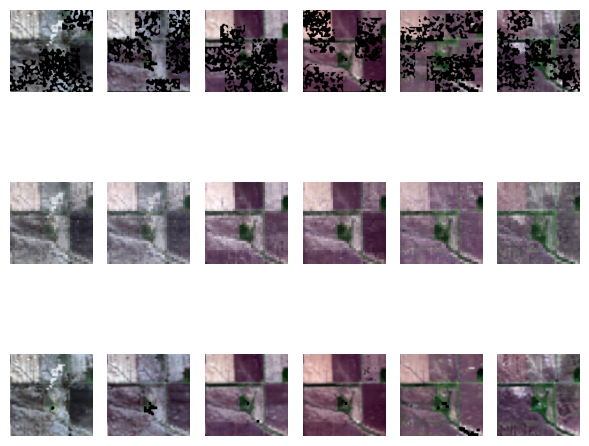

Epoch 90, Train loss.: 4.7276e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0735485..0.88500935].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.077221215..0.9626799].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0009886859..0.91753644].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06268042..0.8139954].


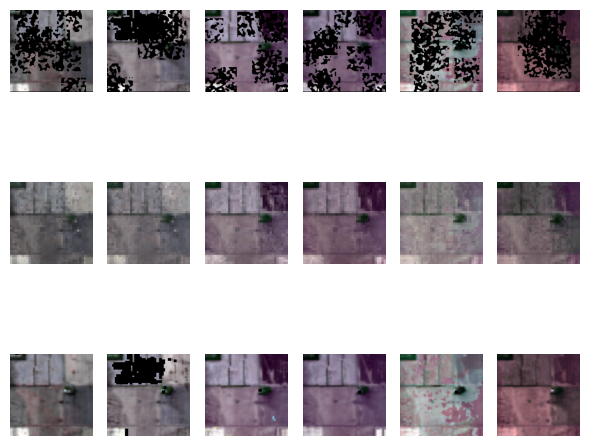

Epoch 91, Train loss.: 4.7489e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.037687935..0.7999275].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09840454..0.8604649].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.035785757..0.8875254].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.050540663..0.7394308].


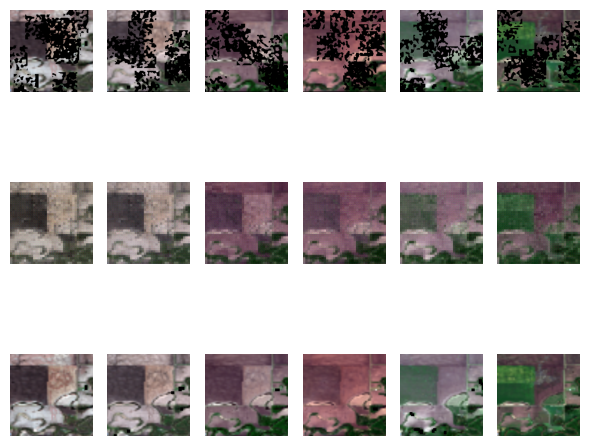

Epoch 92, Train loss.: 4.6925e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.034271926..0.8858152].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0859888..0.8030708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.008202372..0.8632117].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.012988042..0.7438358].


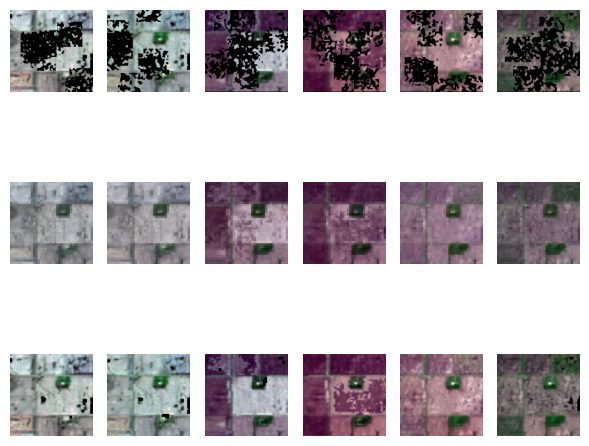

Epoch 93, Train loss.: 4.9318e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.016969878..0.89734155].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.018324655..0.9251913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.009582005..0.880653].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.035055567..0.8373655].


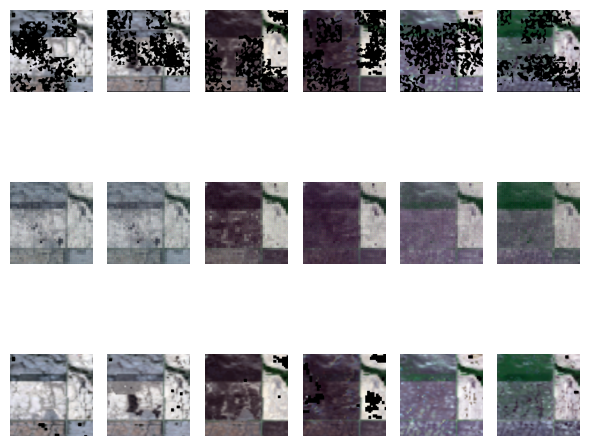

Epoch 94, Train loss.: 4.6897e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.03111438..0.8705154].


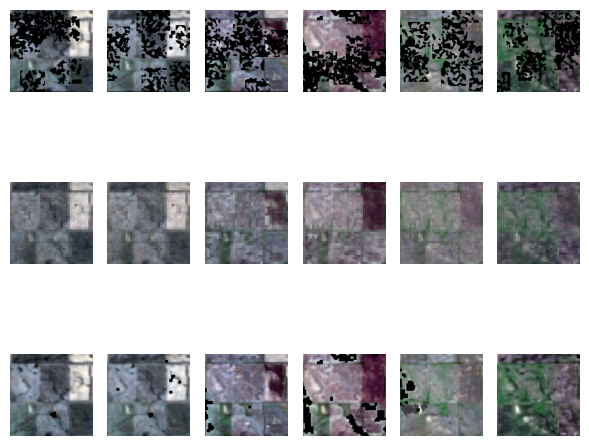

Epoch 95, Train loss.: 4.7069e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.03920051..0.8369318].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.050364584..0.98004377].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.00084674655..1.041747].


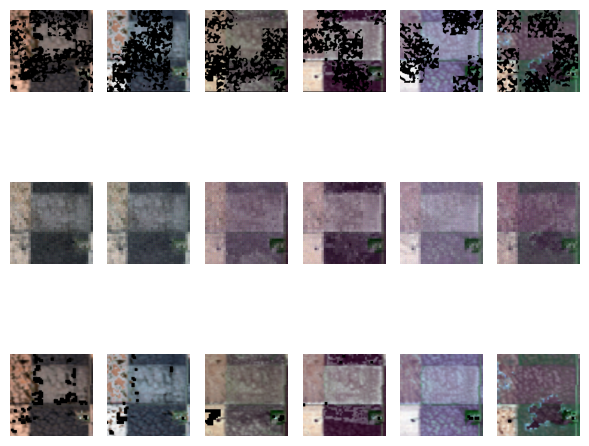

Epoch 96, Train loss.: 4.6873e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.021864913..0.9141061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.033688843..0.88334656].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04558317..0.80564106].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04996888..0.7306603].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0075601656..0.84699214].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06800796..0.5986862].


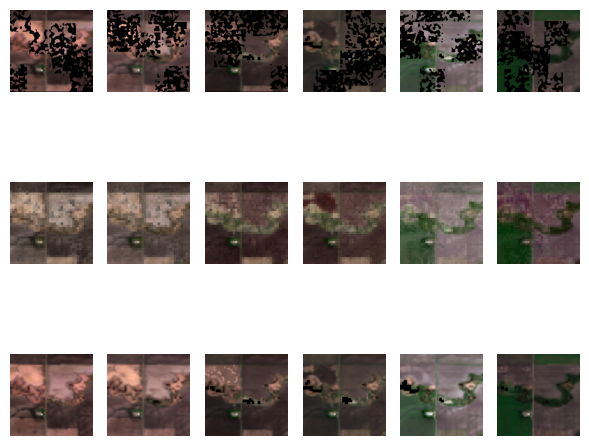

Epoch 97, Train loss.: 4.6790e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.18626077..1.0008675].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.24599099..1.0149568].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05719059..0.9255755].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.075219855..0.9648667].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06071652..1.1158144].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.038133092..1.1401961].


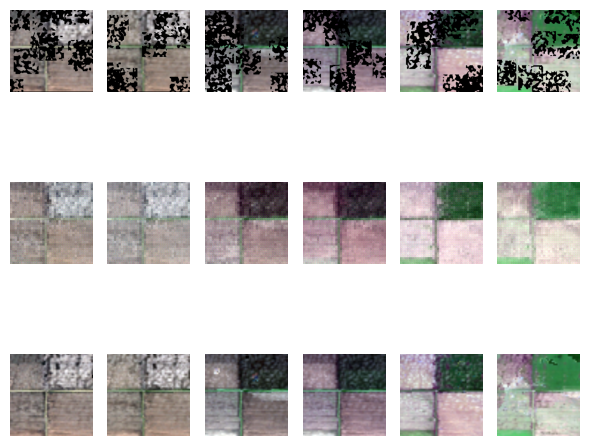

Epoch 98, Train loss.: 4.6589e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04562255..0.83631736].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.076425195..0.8821319].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.061089378..0.98012197].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16088903..0.7646078].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13252316..0.62782776].


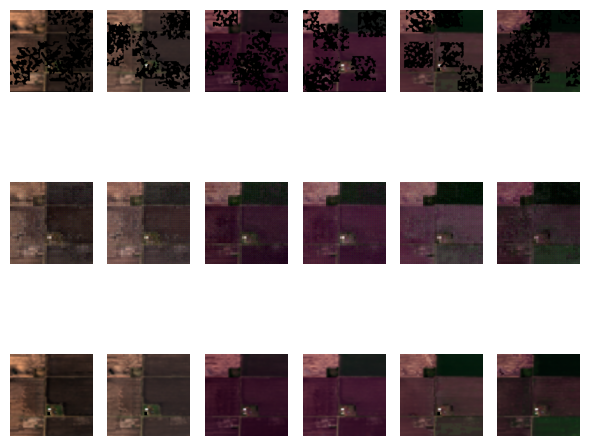

Epoch 99, Train loss.: 4.6850e-01


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.018854715..0.8923077].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.036239468..0.93310434].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0035058511..0.89832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.021934725..0.7707254].


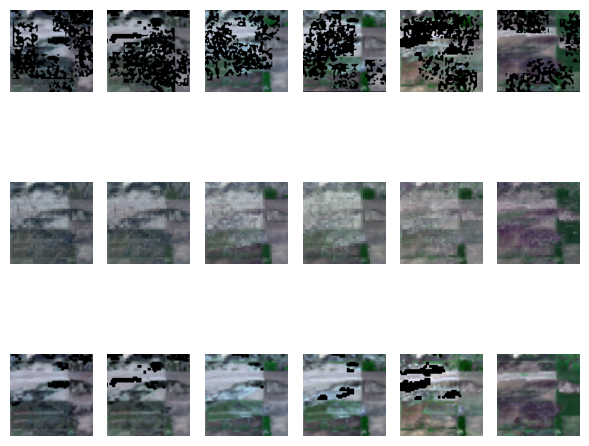

Epoch 100, Train loss.: 4.6758e-01


In [8]:
# --------------------------------------------------------------------
# Start to train the model
# --------------------------------------------------------------------

# Loop over the dataset for the specified number of epochs
for epoch in range(0, epoch):
    model.train()  # Set model to training mode
    train_loss = 0.0  # Initialize training loss for this epoch

    for i, data in enumerate(trainloader):
        # Unpack data from the training loader
        inputs, targets, cloud_mask, added_cloud_mask = data

        # Determine the number of channels per time slice
        channel_each = inputs.shape[1] // time_span
        last_time_start = channel_each * (time_span - 1)
        last_time_end = channel_each * time_span

        optimizerG.zero_grad()  # Zero out the gradients

        # Forward pass through the model
        outputs = model(inputs.to(device))

        # Expand the cloud mask to match the number of channels in output/target
        expanded_cloud_mask = cloud_mask.repeat_interleave(
            model.net.in_chans // time_span, dim=1
        )

        # Apply cloud masks to outputs and targets (to ignore cloud-covered regions)
        masked_outputs = outputs * expanded_cloud_mask.to(device)
        masked_targets = targets.to(device) * expanded_cloud_mask.to(device)

        # Compute the total number of valid (non-cloud) pixels
        valid_pixels_total = cloud_mask.sum()

        # Find which time slice has the most valid pixels
        valid_pixel_counts = cloud_mask.sum(dim=(0, 2, 3))
        max_valid_pixel_index = np.argmax(valid_pixel_counts)
        last_time_start = max_valid_pixel_index * 11
        last_time_end = last_time_start + 11

        # Only compute loss if there are valid pixels
        if valid_pixels_total > 0:
            loss = criterion(
                masked_outputs.to(device),
                masked_targets.to(device),
            )
        else:
            # Avoid NaN gradients if no valid data
            loss = torch.tensor(0.0, device=device, requires_grad=True)

        # Backpropagate the loss
        loss.backward()

        # Clip gradients to prevent exploding gradients
        torch.nn.utils.clip_grad_norm_(
            model.parameters(), max_norm=1, norm_type=1, error_if_nonfinite=True
        )

        # Update model parameters
        optimizerG.step()

        # Accumulate training loss
        train_loss += loss.item()

    # ------------------- Evaluation and Visualization -------------------
    model.eval()  # Set model to evaluation mode

    with torch.no_grad():
        # Randomly pick one batch from validation set for visualization
        random_indices = random.sample(range(0, 5), 1)

        for i, (inputs, targets, cloud_mask, cloud_mask_added) in enumerate(valloader):
            if i in random_indices:
                outputs = model(inputs.to(device)).cpu()  # Get model output

                # Convert inputs/outputs/targets to pseudo-color images for visualization
                input_images, _ = create_time_series_pseudo_color_image(
                    inputs[0, :, :, :].squeeze(0),
                    cloud_mask[0, :, :, :].squeeze(0),
                    cloud_mask_added[0, :, :, :].squeeze(0),
                )
                output_images, _ = create_time_series_pseudo_color_image(
                    outputs[0, :, :, :].squeeze(0),
                    cloud_mask[0, :, :, :].squeeze(0),
                    cloud_mask_added[0, :, :, :].squeeze(0),
                )
                targets_images, _ = create_time_series_pseudo_color_image(
                    targets[0, :, :, :].squeeze(0),
                    cloud_mask[0, :, :, :].squeeze(0),
                    cloud_mask_added[0, :, :, :].squeeze(0),
                )

                # Aggregate images for display
                all_images = [input_images, output_images, targets_images]

                # Plot images (rows: input/output/target, cols: time slices)
                fig, axes = plt.subplots(
                    len(all_images), len(targets_images), figsize=(6, 6)
                )

                for i, image_list in enumerate(all_images):
                    for j in range(len(image_list)):
                        axes[i][j].imshow(image_list[j])
                        axes[i][j].axis("off")

                plt.tight_layout()
                plt.show()
                break  # Only visualize one batch

    # ------------------- Post-epoch Updates -------------------
    scheduler.step()  # Update learning rate according to scheduler
    train_hist.append(train_loss / len(trainloader))  # Save average loss
    save_model(path, model, train_hist, optimizerG, scheduler=scheduler)  # Save model
    print("Epoch {}, Train loss.: {:0.4e}".format(epoch + 1, train_hist[-1]))  # Log

*********** Testing ************ 2025-05-12 13:45:32.122758


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.089370474..1.008505].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0849935..1.0098693].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.038687192..1.0322157].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04238075..0.9682129].


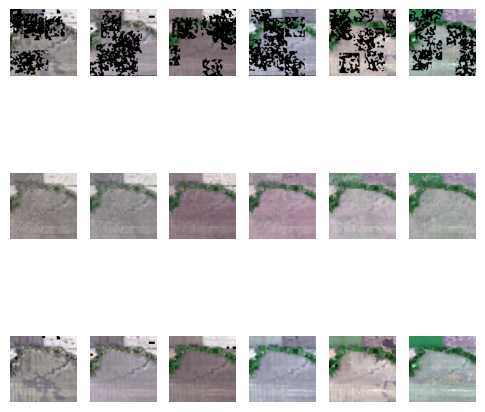

In [9]:
# --------------------------------------------------------------------
# Test the model that has been trained
print("*********** Testing ************", datetime.now())
# --------------------------------------------------------------------

# Create a DataLoader for the validation dataset, with batch size 1 and deterministic shuffling
valloader = DataLoader(
    val_dataset,
    batch_size=1,
    shuffle=True,
    num_workers=0,
    generator=torch.Generator().manual_seed(1),
)

# Create an iterator for the DataLoader
dataiter = iter(valloader)

# Set the model to evaluation mode
model.eval()

# Set the max value for metric calculations (e.g., SSIM, PSNR)
maxval = torch.tensor([1.0], device="cpu")

# Initialize lists to store evaluation metrics
ssim_clean = []
ssim_noise = []
psnr_clean = []
psnr_noise = []
nmse_clean = []
nmse_noise = []

# Select a random index for visualization
random_indices = random.sample(range(25, 30), 1)

# Disable gradient computation for testing
with torch.no_grad():
    for i, _ in enumerate(valloader):
        if i in random_indices:
            # Load a batch of validation data
            inputs, targets, cloud_mask, cloud_mask_added = next(dataiter)

            # Get model outputs for the input
            outputs = model(inputs.to(device)).cpu()

            # Generate pseudo-color images for visualization
            input_images, _ = create_time_series_pseudo_color_image(
                inputs.squeeze(0), cloud_mask.squeeze(0), cloud_mask_added.squeeze(0)
            )
            output_images, _ = create_time_series_pseudo_color_image(
                outputs.squeeze(0), cloud_mask.squeeze(0), cloud_mask_added.squeeze(0)
            )
            targets_images, _ = create_time_series_pseudo_color_image(
                targets.squeeze(0), cloud_mask.squeeze(0), cloud_mask_added.squeeze(0)
            )

            # Organize the visualizations into rows: input, output, and ground truth
            all_images = [
                input_images,
                output_images,
                targets_images,
            ]

            # Create subplots for visualization
            fig, axes = plt.subplots(
                len(all_images), len(targets_images), figsize=(6, 6)
            )

            # Fill each subplot with the corresponding image
            for i, image_list in enumerate(all_images):
                for j in range(len(image_list)):
                    axes[i][j].imshow(image_list[j])
                    axes[i][j].axis("off")

            # Optionally show or save the image
            # plt.tight_layout()
            # plt.show()
            # plt.savefig("output/imagenet_after_spt.png")

            # Optional: Calculate evaluation metrics (commented out)
            # ssim_clean.append(ms_ssim(targets, outputs, maxval[0].item()))
            # ssim_noise.append(ms_ssim(targets, inputs_, maxval[0].item()))
            # psnr_clean.append(psnr(targets[0], outputs[0], maxval[0].item()))
            # psnr_noise.append(psnr(targets[0], inputs_[0], maxval[0].item()))
            # nmse_clean.append(nmse(targets[0], outputs[0]))
            # nmse_noise.append(nmse(targets, inputs_))

    # Optional: Save and summarize metrics (commented out)
    # output_stat = pd.DataFrame()
    # output_stat["ssim_clean"] = ssim_clean
    # output_stat["ssim_noise"] = ssim_noise
    # output_stat.to_csv("output/breakdown.csv")

    # Convert tensor metrics to scalar values
    # output_stat = output_stat.applymap(lambda x: x.item() if isinstance(x, torch.Tensor) else x)

    # Calculate and save mean metrics
    # testing_metrics = output_stat.mean(axis=0)
    # testing_metrics.to_csv("output/testing_metrics.csv")

    # Print average metric scores
    # print(" ssim:", testing_metrics["ssim_clean"])
    # print("*ssim:", testing_metrics["ssim_noise"])
    # print(" psnr:", testing_metrics["psnr_clean"])
    # print("*psnr:", testing_metrics["psnr_noise"])
    # print(" nmse:", testing_metrics["nmse_clean"])
    # print("*nmse:", testing_metrics["nmse_noise"])

# print("*********** ENDED AT ************", datetime.now())

# --------------------------------------------------------------------
# Testing complete for the ViT model trained on the Imagenet dataset
# --------------------------------------------------------------------